**disini data dinamis dimana setiap pola pada timestep , itu di normalisasi dan diskalalisasi , serta ditambah feature  vektor  titik t dengan t-1**
1. filter21 sudah di dropna, sudah di gabung dengan diff1 yaitu range titik t  HANYA BELUM DITRIM
2. filter23, fix siap dilatih sudah di TRIM , sudah di dropna, sudah di gabung dengan diff1 yaitu range titik t dengan t-1
3. diff1 , range titik t dengan t-1


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,rangeY14,rangeY15,rangeY16,rangeY17,rangeY18,rangeY19,rangeY20,timestep,sequence,Label
0,3.742154,7.165813,9.593215,10.000000,8.514934,8.117120,8.729222,8.945818,9.002473,5.153035,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,z
1,3.802600,7.164484,9.641920,10.169304,8.707579,8.219723,8.877703,9.057772,9.107954,5.221573,...,0.002697,0.003920,0.004695,0.000846,0.002381,0.004180,0.006006,1,0,z
2,3.444860,6.922269,9.468247,10.109488,8.635353,8.154394,8.827019,9.028031,9.042329,5.236061,...,0.001099,0.002253,0.001146,-0.002138,-0.000103,0.001073,0.001137,2,0,z
3,3.221517,6.847910,9.423677,10.046895,8.550510,8.098488,8.680855,8.958609,9.071293,5.242561,...,0.000211,0.000014,0.000486,0.001168,0.001797,0.000908,0.000180,3,0,z
4,3.622306,7.124989,9.717703,10.213660,8.601789,8.076038,8.918772,9.164483,9.234196,5.133992,...,0.005304,0.003443,0.001078,0.003114,0.004107,0.003567,0.001854,4,0,z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34523,0.000000,1.115180,3.590649,4.534479,3.502685,6.255964,12.412913,11.002745,8.890337,6.623588,...,-0.006805,-0.007024,-0.006308,-0.006546,-0.006764,-0.006939,-0.006368,51,79,menang
34524,0.000000,0.955466,3.358291,4.276914,3.172892,6.029709,12.174161,10.780608,8.669029,6.472841,...,-0.007322,-0.005932,-0.005446,-0.007264,-0.008233,-0.006259,-0.005172,52,79,menang
34525,0.000000,0.925831,3.253053,4.164071,3.035555,5.898904,11.904604,10.612708,8.594224,6.413521,...,-0.007730,-0.007007,-0.006566,-0.004535,-0.005799,-0.005188,-0.005097,53,79,menang
34526,0.000000,0.754570,3.040855,4.060762,3.070324,5.899555,11.891894,10.664442,8.682059,6.355955,...,-0.005034,-0.004987,-0.005777,-0.005956,-0.004698,-0.004767,-0.005504,54,79,menang


## IMPORT LIBRARY

In [2]:
import os
import pandas as pd
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
import cv2
import numpy as np
import pandas as pd

2025-05-11 15:53:44.329890: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-05-11 15:53:44.340001: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746953624.351972  122596 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746953624.355427  122596 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1746953624.364247  122596 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking 

## FUNGSI NORMALISASI

In [2]:
def normalisasi2(data):
    vektor = [(d-data[0])  for d in data[1:] ]
    return vektor
def normalisasi(data, d2max, d2min=0):
    dmin, dmax = np.min(data), np.max(data)
    normalisasi = ((data - dmin) / (dmax - dmin)) * (d2max - d2min) + d2min
    return normalisasi
def scale_points(points, new_x_max):
    """
    Melakukan transformasi skala pada kumpulan titik berdasarkan nilai maksimum baru untuk sumbu X.
    
    Parameters:
        points (numpy.ndarray): Array 2D berisi koordinat titik, dengan kolom pertama sebagai X dan kedua sebagai Y.
        new_x_max (float): Nilai maksimum baru untuk sumbu X setelah transformasi.
        
    Returns:
        numpy.ndarray: Array 2D dari titik yang telah ditransformasi.
    """
    # Nilai maksimum awal untuk X
    x_max_original = np.max(points[:, 0])
    
    # Hitung skala
    scale = new_x_max / x_max_original
    
    # Transformasi titik berdasarkan skala
    transformed_points = (points * scale)
    
    return transformed_points[:,0],transformed_points[:,1]
    
    

# PREPROCESSING DATA CSV FORM


In [69]:
df = pd.read_csv('csv/dinamic/raw.csv')
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
feature_cols = x_cols + y_cols

# Hitung selisih antar timestep untuk setiap group Label dan sequence
df_diff = df.copy()
df_diff = df_diff.dropna(subset=feature_cols)
df_diff[feature_cols] = df.groupby(['Label', 'sequence'])[feature_cols].diff().fillna(0)

In [70]:
x_rename = {f'X{i}': f'rangeX{i}' for i in range(21)}
y_rename = {f'Y{i}': f'rangeY{i}' for i in range(21)}

# Gabungkan semua mapping
rename_dict = {**x_rename, **y_rename}

# Ganti nama kolom pada df_diff
df_diff.rename(columns=rename_dict, inplace=True)

In [71]:
df_diff

,rangeX0,rangeX1,rangeX2,rangeX3,rangeX4,rangeX5,rangeX6,rangeX7,rangeX8,rangeX9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.001440,0.000604,0.001281,0.002912,0.003227,0.002010,0.002630,0.002136,0.002049,0.001549,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,-0.002824,-0.001262,-0.000336,0.001204,0.001036,0.001129,0.001327,0.001610,0.001125,0.002208,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,-0.001079,0.000935,0.001338,0.001095,0.000794,0.001185,-0.000035,0.001002,0.002332,0.002029,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.003111,0.001439,0.001668,-0.000053,-0.001614,-0.002611,0.000909,0.000476,-0.000105,-0.003776,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34999,-0.003077,-0.002185,-0.004149,-0.006537,-0.008066,-0.004009,-0.004783,-0.004087,-0.003984,-0.004075,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
35000,-0.002743,-0.004903,-0.005885,-0.006226,-0.007202,-0.005802,-0.005971,-0.005747,-0.005735,-0.004781,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
35001,-0.003874,-0.004275,-0.005297,-0.005400,-0.005731,-0.005643,-0.007519,-0.006145,-0.004886,-0.004677,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
35002,-0.005059,-0.007374,-0.007928,-0.006456,-0.004589,-0.005050,-0.005231,-0.004359,-0.003871,-0.005837,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [72]:

df_diff.iloc[:,:42].to_csv('csv/dinamic/diff1.csv',index=False)

In [26]:
pd.read_csv('csv/dinamic/diff.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.001440,0.000604,0.001281,0.002912,0.003227,0.002010,0.002630,0.002136,0.002049,0.001549,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,-0.002824,-0.001262,-0.000336,0.001204,0.001036,0.001129,0.001327,0.001610,0.001125,0.002208,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,-0.001079,0.000935,0.001338,0.001095,0.000794,0.001185,-0.000035,0.001002,0.002332,0.002029,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.003111,0.001439,0.001668,-0.000053,-0.001614,-0.002611,0.000909,0.000476,-0.000105,-0.003776,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33831,-0.003077,-0.002185,-0.004149,-0.006537,-0.008066,-0.004009,-0.004783,-0.004087,-0.003984,-0.004075,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
33832,-0.002743,-0.004903,-0.005885,-0.006226,-0.007202,-0.005802,-0.005971,-0.005747,-0.005735,-0.004781,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
33833,-0.003874,-0.004275,-0.005297,-0.005400,-0.005731,-0.005643,-0.007519,-0.006145,-0.004886,-0.004677,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
33834,-0.005059,-0.007374,-0.007928,-0.006456,-0.004589,-0.005050,-0.005231,-0.004359,-0.003871,-0.005837,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [8]:
df = pd.read_csv('csv/dinamic/raw.csv')
df[df['sequence']<80]

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33831,0.260127,0.275204,0.308674,0.321435,0.307485,0.344711,0.427956,0.408890,0.380329,0.349681,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
33832,0.257383,0.270302,0.302789,0.315210,0.300283,0.338908,0.421985,0.403143,0.374593,0.344900,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
33833,0.253509,0.266026,0.297492,0.309809,0.294551,0.333265,0.414466,0.396999,0.369707,0.340223,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
33834,0.248450,0.258652,0.289564,0.303354,0.289962,0.328215,0.409235,0.392639,0.365836,0.334386,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [39]:
pd.read_csv('csv/dinamic/diff.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffX16,diffY16,diffX17,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,0.000801,0.004695,0.000622,0.000846,0.000324,0.002381,0.000733,0.004180,0.001766,0.006006
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,0.000918,0.001146,0.002012,-0.002138,0.001003,-0.000103,0.000524,0.001073,0.000335,0.001137
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,0.000844,0.000486,0.001941,0.001168,0.000348,0.001797,0.000822,0.000908,0.001056,0.000180
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,0.002633,0.001078,-0.002308,0.003114,0.002176,0.004107,0.002032,0.003567,0.001054,0.001854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33831,0.260127,0.275204,0.308674,0.321435,0.307485,0.344711,0.427956,0.408890,0.380329,0.349681,...,-0.003933,-0.006308,-0.003338,-0.006546,-0.004372,-0.006764,-0.003640,-0.006939,-0.002779,-0.006368
33832,0.257383,0.270302,0.302789,0.315210,0.300283,0.338908,0.421985,0.403143,0.374593,0.344900,...,-0.003962,-0.005446,-0.003732,-0.007264,-0.004371,-0.008233,-0.004441,-0.006259,-0.004198,-0.005172
33833,0.253509,0.266026,0.297492,0.309809,0.294551,0.333265,0.414466,0.396999,0.369707,0.340223,...,-0.003274,-0.006566,-0.003216,-0.004535,-0.004285,-0.005799,-0.002868,-0.005188,-0.002532,-0.005097
33834,0.248450,0.258652,0.289564,0.303354,0.289962,0.328215,0.409235,0.392639,0.365836,0.334386,...,-0.006064,-0.005777,-0.007324,-0.005956,-0.004757,-0.004698,-0.005542,-0.004767,-0.005940,-0.005504


In [ ]:
df_processed.t

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffX16,diffY16,diffX17,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20
0,0.374215,0.716581,0.959322,1.000000,0.851493,0.811712,0.872922,0.894582,0.900247,0.515303,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.380260,0.716448,0.964192,1.016930,0.870758,0.821972,0.887770,0.905777,0.910795,0.522157,...,0.000801,0.004695,0.000622,0.000846,0.000324,0.002381,0.000733,0.004180,0.001766,0.006006
2,0.344486,0.692227,0.946825,1.010949,0.863535,0.815439,0.882702,0.902803,0.904233,0.523606,...,0.000918,0.001146,0.002012,-0.002138,0.001003,-0.000103,0.000524,0.001073,0.000335,0.001137
3,0.322152,0.684791,0.942368,1.004689,0.855051,0.809849,0.868085,0.895861,0.907129,0.524256,...,0.000844,0.000486,0.001941,0.001168,0.000348,0.001797,0.000822,0.000908,0.001056,0.000180
4,0.362231,0.712499,0.971770,1.021366,0.860179,0.807604,0.891877,0.916448,0.923420,0.513399,...,0.002633,0.001078,-0.002308,0.003114,0.002176,0.004107,0.002032,0.003567,0.001054,0.001854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33831,0.000000,0.111518,0.359065,0.453448,0.350269,0.625596,1.241291,1.100274,0.889034,0.662359,...,-0.003933,-0.006308,-0.003338,-0.006546,-0.004372,-0.006764,-0.003640,-0.006939,-0.002779,-0.006368
33832,0.000000,0.095547,0.335829,0.427691,0.317289,0.602971,1.217416,1.078061,0.866903,0.647284,...,-0.003962,-0.005446,-0.003732,-0.007264,-0.004371,-0.008233,-0.004441,-0.006259,-0.004198,-0.005172
33833,0.000000,0.092583,0.325305,0.416407,0.303556,0.589890,1.190460,1.061271,0.859422,0.641352,...,-0.003274,-0.006566,-0.003216,-0.004535,-0.004285,-0.005799,-0.002868,-0.005188,-0.002532,-0.005097
33834,0.000000,0.075457,0.304086,0.406076,0.307032,0.589956,1.189189,1.066444,0.868206,0.635595,...,-0.006064,-0.005777,-0.007324,-0.005956,-0.004757,-0.004698,-0.005542,-0.004767,-0.005940,-0.005504


In [44]:
df_processed.to_csv('csv/dinamic/filter.csv',index=False)

In [74]:
df1 = df_processed.dropna(subset=x_cols + y_cols)

In [75]:
def reset_timestep(group):
    group = group.sort_values('timestep').copy()
    group['timestep'] = np.arange(0, len(group) )
    return group

df = df1.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)
df

/tmp/ipykernel_4356/2244302984.py:6: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df1.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,3.742154,7.165813,9.593215,10.000000,8.514934,8.117120,8.729222,8.945818,9.002473,5.153035,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,3.802600,7.164484,9.641920,10.169304,8.707579,8.219723,8.877703,9.057772,9.107954,5.221573,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,3.444860,6.922269,9.468247,10.109488,8.635353,8.154394,8.827019,9.028031,9.042329,5.236061,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,3.221517,6.847910,9.423677,10.046895,8.550510,8.098488,8.680855,8.958609,9.071293,5.242561,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,3.622306,7.124989,9.717703,10.213660,8.601789,8.076038,8.918772,9.164483,9.234196,5.133992,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34523,0.000000,1.115180,3.590649,4.534479,3.502685,6.255964,12.412913,11.002745,8.890337,6.623588,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
34524,0.000000,0.955466,3.358291,4.276914,3.172892,6.029709,12.174161,10.780608,8.669029,6.472841,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
34525,0.000000,0.925831,3.253053,4.164071,3.035555,5.898904,11.904604,10.612708,8.594224,6.413521,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
34526,0.000000,0.754570,3.040855,4.060762,3.070324,5.899555,11.891894,10.664442,8.682059,6.355955,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [76]:
df.to_csv('csv/dinamic/filter2.csv',index=False)

In [ ]:
df = pd.read_csv('csv/dinamic/filter2.csv')
df2=  pd.read_csv('csv/dinamic/diff1.csv')

In [103]:
pd.read_csv('csv/dinamic/filter23.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,rangeY14,rangeY15,rangeY16,rangeY17,rangeY18,rangeY19,rangeY20,timestep,sequence,Label
0,4.381414,7.616835,8.765126,8.332958,7.805540,6.157201,6.715614,7.389939,7.128646,4.040639,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,10
1,4.528607,7.674925,8.830429,8.421045,7.851690,6.125712,6.655404,7.312868,6.982766,4.023276,...,-0.000010,0.000232,-0.000344,0.000019,-0.000405,-0.000088,0.000018,1,0,10
2,4.624905,7.788262,8.919089,8.496227,7.998507,6.186356,6.888423,7.566257,7.197565,4.041390,...,0.001459,0.001443,-0.000066,-0.000902,0.000738,0.001122,0.000554,2,0,10
3,4.493501,7.714484,8.888080,8.502352,7.981503,6.269107,6.775439,7.416985,7.134527,4.112966,...,0.001145,-0.000762,0.000544,0.001996,0.000770,-0.000827,-0.000808,3,0,10
4,4.170126,7.596507,8.878470,8.418149,7.827426,6.229121,6.876044,7.447469,7.178023,4.064052,...,0.001183,-0.005789,0.001372,0.003160,0.004845,0.001161,0.006420,4,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17995,3.574393,7.912620,10.628363,10.751658,8.762346,7.450463,7.571460,8.093296,8.269872,4.351254,...,-0.000465,-0.000450,-0.003213,-0.007125,-0.009862,-0.009608,-0.008243,20,79,z
17996,3.030460,7.357853,9.969697,10.168778,8.737189,6.087379,7.668525,8.410638,8.015350,3.363355,...,0.011793,0.008036,0.004677,0.006249,0.005908,0.000572,-0.003990,21,79,z
17997,2.287451,0.409902,0.000000,0.765257,2.005500,4.112441,5.159406,4.432095,3.673453,6.186464,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,22,79,z
17998,2.978120,0.434489,0.000000,1.905158,4.520879,5.043835,6.541789,4.980147,3.497161,7.600094,...,-0.000727,0.000192,-0.002066,0.000110,0.001993,0.002627,0.001636,23,79,z


In [78]:
import pandas as pd

# Baca kedua file
df = pd.read_csv('csv/dinamic/filter2.csv')
df2 = pd.read_csv('csv/dinamic/diff1.csv')

# Gabungkan secara horizontal
df_combined = pd.concat([df, df2], axis=1)
df_combined


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,rangeY11,rangeY12,rangeY13,rangeY14,rangeY15,rangeY16,rangeY17,rangeY18,rangeY19,rangeY20
0,3.742154,7.165813,9.593215,10.000000,8.514934,8.117120,8.729222,8.945818,9.002473,5.153035,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,3.802600,7.164484,9.641920,10.169304,8.707579,8.219723,8.877703,9.057772,9.107954,5.221573,...,0.000934,0.001209,0.000376,0.002697,0.003920,0.004695,0.000846,0.002381,0.004180,0.006006
2,3.444860,6.922269,9.468247,10.109488,8.635353,8.154394,8.827019,9.028031,9.042329,5.236061,...,0.003664,0.001971,-0.001539,0.001099,0.002253,0.001146,-0.002138,-0.000103,0.001073,0.001137
3,3.221517,6.847910,9.423677,10.046895,8.550510,8.098488,8.680855,8.958609,9.071293,5.242561,...,-0.000679,0.001047,0.001294,0.000211,0.000014,0.000486,0.001168,0.001797,0.000908,0.000180
4,3.622306,7.124989,9.717703,10.213660,8.601789,8.076038,8.918772,9.164483,9.234196,5.133992,...,0.004100,0.003342,0.002774,0.005304,0.003443,0.001078,0.003114,0.004107,0.003567,0.001854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34523,0.000000,1.115180,3.590649,4.534479,3.502685,6.255964,12.412913,11.002745,8.890337,6.623588,...,-0.005793,-0.005142,-0.005544,-0.006805,-0.007024,-0.006308,-0.006546,-0.006764,-0.006939,-0.006368
34524,0.000000,0.955466,3.358291,4.276914,3.172892,6.029709,12.174161,10.780608,8.669029,6.472841,...,-0.005291,-0.004176,-0.006124,-0.007322,-0.005932,-0.005446,-0.007264,-0.008233,-0.006259,-0.005172
34525,0.000000,0.925831,3.253053,4.164071,3.035555,5.898904,11.904604,10.612708,8.594224,6.413521,...,-0.007293,-0.007054,-0.004060,-0.007730,-0.007007,-0.006566,-0.004535,-0.005799,-0.005188,-0.005097
34526,0.000000,0.754570,3.040855,4.060762,3.070324,5.899555,11.891894,10.664442,8.682059,6.355955,...,-0.004177,-0.004229,-0.006263,-0.005034,-0.004987,-0.005777,-0.005956,-0.004698,-0.004767,-0.005504


In [79]:
for col in ['timestep', 'sequence', 'Label']:
    if col in df2.columns:
        df2 = df2.drop(columns=col)

# Gabungkan ulang setelah memastikan tidak duplikat
df_combined = pd.concat([df, df2], axis=1)

# Pindahkan 'timestep', 'sequence', 'Label' ke 3 kolom terakhir
cols = [col for col in df_combined.columns if col not in ['timestep', 'sequence', 'Label']]
cols += ['timestep', 'sequence', 'Label']
df_combined = df_combined[cols]

In [81]:
df_combined.to_csv('csv/dinamic/filter21.csv',index=False)


In [4]:

def feature_extraction_1(image,data,k,target,label,data_separated,i):
    global X_before, Y_before
            
    global next_data
    
    # Konversi ke RGB untuk MediaPipe
    frame_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=frame_rgb)
    
    # Deteksi tangan
    detection_result = detector.detect(mp_image)
    if not detection_result.hand_landmarks:
        print(f"Tidak ada tangan terdeteksi dalam {image_file} in label {target} di data ke {label}")
        os.remove(image_path)
        print(f'remove {image_path}')
    
    # Format data sesuai permintaan
    for hand_idx, hand in enumerate(detection_result.hand_landmarks):
        x_coords = []
        y_coords = []
        z_coords = []
        
         # Ekstrak semua titik koordinat
        nilai_X = np.array([landmark.x for landmark in hand])
        nilai_Y = np.array([landmark.y for landmark in hand])
        # nilai_Z = [np.array([landmark.y for landmark in hand])[0]
        nilai_Z = np.array([landmark.y for landmark in hand])
        if k:
            vektorX = (nilai_X[[4,5,8,12,13,18,20]] - X_before)*100
            vektorY = (nilai_Y[[2,4,5,8,12,13,18,20]]-Y_before)*100
        else :
            # Jika X_before belum diinisiasi, set vektorX menjadi 0
            vektorX = [0,0,0,0,0,0,0]
            vektorY =[0,0,0,0,0,0,0,0]

            k=True
    
        
        X_before =nilai_X[[4,5,8,12,13,18,20]]
        Y_before=nilai_Y[[2,4,5,8,12,13,18,20]]
        # newX = normalisasi(nilai_X,(np.max(nilai_X)-np.min(nilai_X))) 
        # newY = normalisasi(nilai_Y,(np.max(nilai_Y)-np.min(nilai_Y)))
        newX = normalisasi(nilai_X,(np.max(nilai_X)-np.min(nilai_X))) 
        newY = normalisasi(nilai_Y,(np.max(nilai_Y)-np.min(nilai_Y)))
        newXY = np.column_stack((newX, newY) )  # Simpan dalam list koordinat int
            
        newX , newY = scale_points(newXY,10)
      
        # Buat dictionary untuk DataFrame dengan format X1, X2,..., Y1, Y2,..., Z
        row_data = {f"X{idx}": x for idx, x in zip(range(21),nilai_X)}
        row_data.update({f"Y{idx}": y for idx, y in zip(range(21),nilai_Y)})
        row_data.update({f"Z{idx}": y for idx, y in zip(range(21),nilai_Z)})
        row_data.update({f"rangeX{idx}": y for idx, y in zip(range(0,7),vektorX)})
        row_data.update({f"rangeY{idx}": y for idx, y in zip(range(0,8),vektorY)})
        row_data ['timestep'] = i 
     

        #row_data["Z"] = z_coords[0] if z_coords else None  # Ambil satu nilai Z sebagai referensi
        # row_data.update({f"Z{idx+1}": y for idx, y in enumerate(y_coords)}) 
        row_data["Label"] = target
        row_data["Sub 2"] = int(label+next_data)  # Label tetap "a"
     
        data.append(row_data)
        data_separated.append(row_data)
        return data,k,data_separated

In [ ]:

def feature_extraction_2(image,data,k,target,label,data_separated,i):
    global X_before, Y_before
            
    global next_data
    
    # Konversi ke RGB untuk MediaPipe
    frame_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=frame_rgb)
    
    # Deteksi tangan
    detection_result = detector.detect(mp_image)
    if not detection_result.hand_landmarks:
        print(f"Tidak ada tangan terdeteksi dalam {image_file} in label {target} di data ke {label}")
        os.remove(image_path)
        print(f'remove {image_path}')
    # Format data sesuai permintaan
    for hand_idx, hand in enumerate(detection_result.hand_landmarks):
        x_coords = []
        y_coords = []
        z_coords = []
        
         # Ekstrak semua titik koordinat
        nilai_X = np.array([landmark.x for landmark in hand])
        nilai_Y = np.array([landmark.y for landmark in hand])

        nilai_Z = np.array([landmark.y for landmark in hand])
 
        row_data = {f"X{idx}": x for idx, x in zip(range(21),nilai_X)}
        row_data.update({f"Y{idx}": y for idx, y in zip(range(21),nilai_Y)})
        row_data.update({f"Z{idx}": y for idx, y in zip(range(21),nilai_Z)})

        row_data ['timestep'] = i 
     


        row_data["Label"] = target
        row_data["Sub 2"] = int(label+next_data)  # Label tetap "a"
     
        data.append(row_data)
        data_separated.append(row_data)
        return data,k,data_separated

In [6]:
import time

# Mencatat waktu mulai program
start_time = time.time()

# Simulasi proses atau kode yang akan dijalankan
print("Program dimulai...")
time.sleep(3)  # Menunggu selama 3 detik untuk mensimulasikan proses yang berlangsung

# Mencatat waktu selesai program
end_time = time.time()

# Menghitung durasi eksekusi dalam detik
execution_time = end_time - start_time

# Menampilkan waktu eksekusi
print(f"Waktu eksekusi: {execution_time:.2f} detik")


Program dimulai...
Waktu eksekusi: 3.00 detik


## COLLECTING DATA WITH TRIMMED OR CUT OFF FRAME TO 22 TIMESTEP 
**PURE DATA**

In [7]:
import cv2
import os
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
import numpy as np
data_separated=[]
X_before,Y_before=0,0
# STEP 2: Buat objek HandLandmarker
base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
options = vision.HandLandmarkerOptions(
    base_options=base_options,
    num_hands=2,
    running_mode=vision.RunningMode.IMAGE  # Gunakan mode gambar
)
detector = vision.HandLandmarker.create_from_options(options)
data = []
next_data = 0


# Mendapatkan semua folder (target) di dalam folder 'video2'
video_path = "video2" 
# video_path = "video2"# Ganti dengan path folder video kamu
allTarget = [f for f in os.listdir(video_path) if os.path.isdir(os.path.join(video_path, f)) is not f.startswith('.')] # Hanya ambil folder
allTarget = ['cepat']
# Folder untuk menyimpan frame
output_folder = "frame_v2"
# output_folder = "frame_v2"
os.makedirs(output_folder, exist_ok=True)
print(allTarget)
# Buka video dan proses setiap folder (target)
for k,target in enumerate(allTarget):
    # Path ke folder video
    video_folder_path = os.path.join(video_path, target)
    
    # Ambil semua file mp4 di dalam folder target
    video_files = sorted([f for f in os.listdir(video_folder_path) if f.endswith('.mp4') and not f.startswith('.')],key=lambda x:int(x.split('.')[0]))[:3]

 
    # Buat folder output berdasarkan nama folder target
    target_output_folder = os.path.join(output_folder, f"{target}")
    if not os.path.isdir(target_output_folder):
        os.makedirs(target_output_folder, exist_ok=True)
    # allSample = sorted([f for f in os.listdir(target_output_folder) if not f.startswith('.')],key=lambda x: int(x.split('.')[0]))
  

    
#     # Proses setiap file video dalam folder target
    for video_index, video_file in enumerate(video_files):
        
#         # Buat folder no_video untuk setiap video berdasarkan urutan
        video_output_folder = os.path.join(target_output_folder, f"{video_index+ 1}")
       
        # video_output_folder = os.path.join(target_output_folder, f"{video_index + int(allSample[len(allSample)-1])+ 1}")
        os.makedirs(video_output_folder, exist_ok=True)
        
        # Path ke file video
        video_file_path = os.path.join(video_folder_path, video_file)

        # Buka video
        cap = cv2.VideoCapture(video_file_path)
        
        # Periksa apakah video berhasil dibuka
        if not cap.isOpened():
            
            continue
        
        print(f"Mendeteksi tangan dalam video {video_file_path}...")
        
        detected_frames = []  # List untuk menyimpan frame yang terdeteksi tangan
        frame_count = 0
        
        while True:
            ret, frame = cap.read()
     
            if not ret:
                break  # Keluar jika video selesai
            
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=frame_rgb)
        
            # Deteksi tangan
            detection_result = detector.detect(mp_image)
        
            if detection_result.hand_landmarks:
                detected_frames.append(frame)  # Simpan hanya frame yang memiliki tangan
            else:
                
                continue
            frame_count += 1
        
       
        
        # Pastikan ada cukup frame terdeteksi tangan
        total_detected = len(detected_frames)
        print(total_detected)
        if total_detected <22:
            print(f"Hanya {total_detected} frame yang terdeteksi tangan dalam video {video_file_path}, kurang dari 40.")
            print('finally removed')    
            os.remove(video_file_path)
            continue  # Melanjutkan ke video berikutnya
        for path in os.listdir(video_output_folder):
            os.remove(os.path.join(video_output_folder,path))
            
 
        # Hitung interval untuk memilih 50 frame
        frame_interval = total_detected / 22
        d= False
        # Simpan 50 frame yang telah dipilih
        for i in range(22):
            frame = detected_frames[int(np.ceil(i * frame_interval))]  # Ambil frame secara merata
            #filename = os.path.join(video_output_folder, f"{i+1}.jpg")
            # cv2.imwrite(filename, frame)
            data,d,data_separated = feature_extraction(frame,data,d,target,video_index,data_separated,i)
        

        # Tutup video setelah selesai membaca semua frame
        cap.release()
    data_separated = pd.DataFrame(data_separated)
    data_separated.to_csv(f'csv/{target}_pure.csv',index=False)
    # data_lama = pd.read_csv(f'csv_dinamic/{target}.csv')
    # pd.concat([data_lama, data_separated], ignore_index=True).to_csv(f'csv_dinamic/{target}.csv',index=False)
    
    data_separated = []

print("Proses selesai, frame-frame telah disimpan.")


['cepat']
Mendeteksi tangan dalam video video2/cepat/1.mp4...


I0000 00:00:1746346390.740420   99858 gl_context_egl.cc:85] Successfully initialized EGL. Major : 1 Minor: 5
I0000 00:00:1746346390.742835   99953 gl_context.cc:369] GL version: 3.2 (OpenGL ES 3.2 Mesa 24.2.8-1ubuntu1~24.04.1), renderer: Mesa Intel(R) Graphics (RPL-S)
INFO: Created TensorFlow Lite XNNPACK delegate for CPU.
W0000 00:00:1746346390.766256   99957 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1746346390.782485   99970 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1746346390.829310   99958 landmark_projection_calculator.cc:186] Using NORM_RECT without IMAGE_DIMENSIONS is only supported for the square ROI. Provide IMAGE_DIMENSIONS or use PROJECTION_MATRIX.


58


NameError: name 'feature_extraction' is not defined

## COLLECTING DATA ALL FRAME
**RAW DATA**

In [9]:

def feature_extraction_3(image, data, target, label, data_separated, i, next_data):
    global X_before, Y_before

    # Konversi ke RGB untuk MediaPipe
    frame_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=frame_rgb)
    
    # Deteksi tangan
    detection_result = detector.detect(mp_image)
    
    if not detection_result.hand_landmarks:
       
   
        
        # Jika tidak ada tangan terdeteksi, isi row_data dengan NaN
        row_data = {f"X{idx}": np.nan for idx in range(21)}
        row_data.update({f"Y{idx}": np.nan for idx in range(21)})
        row_data.update({f"Z{idx}": np.nan for idx in range(21)})

        row_data['timestep'] = i
        row_data["Label"] = target
        row_data["sequence"] = int(label + next_data)  # Label tetap "a"

        data.append(row_data)
        data_separated.append(row_data)
        

    # Jika tangan terdeteksi, ekstrak koordinat tangan
    for hand_idx, hand in enumerate(detection_result.hand_landmarks):
        x_coords = []
        y_coords = []
        z_coords = []
        
        # Ekstrak semua titik koordinat
        nilai_X = np.array([landmark.x for landmark in hand])
        nilai_Y = np.array([landmark.y for landmark in hand])
        nilai_Z = np.array([landmark.z for landmark in hand])
        
        # Simpan koordinat X, Y, Z dalam row_data
        row_data = {f"X{idx}": x for idx, x in zip(range(21), nilai_X)}
        row_data.update({f"Y{idx}": y for idx, y in zip(range(21), nilai_Y)})
        row_data.update({f"Z{idx}": z for idx, z in zip(range(21), nilai_Z)})

        row_data['timestep'] = i
        row_data["Label"] = target
        row_data["sequence"] = int(label + next_data)  # Label tetap "a"
        
        data.append(row_data)
        data_separated.append(row_data)

    return data, data_separated

In [11]:
np.array([3,4,5])[1:]

array([4, 5])

In [15]:
import cv2
import os
import mediapipe as mp
import pandas as pd
import numpy as np
from mediapipe.tasks import python
from mediapipe.tasks.python import vision

# Initialize MediaPipe hand landmarker
base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
options = vision.HandLandmarkerOptions(
    base_options=base_options,
    num_hands=2,
    running_mode=vision.RunningMode.IMAGE  # Gunakan mode gambar
)
detector = vision.HandLandmarker.create_from_options(options)

data_separated = []
X_before, Y_before = 0, 0
data = []
next_data = 0

# Mendapatkan semua folder (target) di dalam folder 'video2'
video_path = "video2"

allTarget = [f for f in os.listdir(video_path) if os.path.isdir(os.path.join(video_path, f)) and not f.startswith('.')] # Hanya ambil folder


for k, target in enumerate(allTarget):
    video_folder_path = os.path.join(video_path, target)
    
    # Ambil semua file mp4 di dalam folder target
    video_files = sorted([f for f in os.listdir(video_folder_path) if f.endswith('.mp4') and not f.startswith('.')], key=lambda x: int(x.split('.')[0]))

    # Proses setiap file video dalam folder target
    for video_index, video_file in enumerate(video_files):
        video_file_path = os.path.join(video_folder_path, video_file)

        # Buka video
        cap = cv2.VideoCapture(video_file_path)

        # Periksa apakah video berhasil dibuka
        if not cap.isOpened():
            continue

        print(f"Mendeteksi tangan dalam video {video_file_path}...")

        detected_frames = []  # List untuk menyimpan frame yang terdeteksi tangan
        frame_count = 0

        while True:
            ret, frame = cap.read()

            if not ret:
                break  # Keluar jika video selesai

            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=frame_rgb)
        
            # Deteksi tangan
            detection_result = detector.detect(mp_image)

            # Ekstraksi fitur jika tangan terdeteksi
            data, data_separated = feature_extraction_3(frame, data, target, video_index, data_separated, frame_count, next_data)
         
            frame_count += 1

        cap.release()

    # Simpan data yang telah diproses ke dalam file CSV untuk setiap target
    data_separated_df = pd.DataFrame(data_separated)
#     df_before = pd.read_csv(f'csv_separated/dinamic/raw/{target}.csv')



# # Gabungkan secara vertikal (baris)
#     combined_df = pd.concat([df_before, data_separated_df], ignore_index=True)
    data_separated_df.to_csv(f'csv_separated/dinamic/raw/{target}.csv', index=False)

    data_separated = []  # Reset data_separated untuk target berikutnya

print("Proses selesai, frame-frame telah disimpan.")


I0000 00:00:1746954497.520022  122596 gl_context_egl.cc:85] Successfully initialized EGL. Major : 1 Minor: 5
I0000 00:00:1746954497.523492  123744 gl_context.cc:369] GL version: 3.2 (OpenGL ES 3.2 Mesa 24.2.8-1ubuntu1~24.04.1), renderer: Mesa Intel(R) Graphics (RPL-S)
W0000 00:00:1746954497.546834  123748 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.
W0000 00:00:1746954497.560511  123755 inference_feedback_manager.cc:114] Feedback manager requires a model with a single signature inference. Disabling support for feedback tensors.


Mendeteksi tangan dalam video video2/cepat/1.mp4...
Mendeteksi tangan dalam video video2/cepat/2.mp4...
Mendeteksi tangan dalam video video2/cepat/3.mp4...
Mendeteksi tangan dalam video video2/cepat/4.mp4...
Mendeteksi tangan dalam video video2/cepat/5.mp4...
Mendeteksi tangan dalam video video2/cepat/6.mp4...
Mendeteksi tangan dalam video video2/cepat/7.mp4...
Mendeteksi tangan dalam video video2/cepat/8.mp4...
Mendeteksi tangan dalam video video2/cepat/9.mp4...
Mendeteksi tangan dalam video video2/cepat/10.mp4...
Mendeteksi tangan dalam video video2/cepat/11.mp4...
Mendeteksi tangan dalam video video2/cepat/12.mp4...
Mendeteksi tangan dalam video video2/cepat/13.mp4...
Mendeteksi tangan dalam video video2/cepat/14.mp4...
Mendeteksi tangan dalam video video2/cepat/15.mp4...
Mendeteksi tangan dalam video video2/cepat/16.mp4...
Mendeteksi tangan dalam video video2/cepat/17.mp4...
Mendeteksi tangan dalam video video2/cepat/18.mp4...
Mendeteksi tangan dalam video video2/cepat/19.mp4...
Me

In [14]:
df_before = pd.read_csv(f'csv_separated/dinamic/raw/menang.csv')
df_before.sequence.unique()

array([80, 81, 82, 83, 84])

## COMBINED I
COMBINE VERTICAL FILE CSV DENGAN LABEL YANG BERBEDA

In [16]:
import pandas as pd
import glob

# Path tempat file CSV berada
path = 'csv_separated/dinamic/raw/*.csv'

# Dapatkan daftar semua file CSV
all_files = glob.glob(path)

# Gabungkan semua CSV ke dalam satu DataFrame
df_combined = pd.concat((pd.read_csv(f) for f in all_files), ignore_index=True)

# Simpan hasil gabungan ke file CSV baru (opsional)
df_combined.to_csv('csv/dinamic/raw.csv', index=False)

# Tampilkan DataFrame
df_combined.head()


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0


In [17]:
df_combined

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36127,0.282759,0.234133,0.204884,0.181396,0.152710,0.252299,0.274107,0.275133,0.268212,0.287347,...,-0.007807,-0.005174,-0.009208,-0.020840,-0.013091,-0.008183,-0.007271,28,menang,85
36128,0.276687,0.226964,0.196593,0.172144,0.141968,0.243984,0.263199,0.264432,0.257856,0.278791,...,-0.005999,-0.003285,-0.007513,-0.019595,-0.010809,-0.005792,-0.005063,29,menang,85
36129,0.269913,0.221908,0.191276,0.167800,0.138214,0.236826,0.260907,0.263311,0.256184,0.270726,...,-0.010174,-0.006785,-0.010045,-0.022561,-0.015541,-0.010726,-0.009699,30,menang,85
36130,0.262752,0.215371,0.184189,0.161612,0.133340,0.230129,0.258889,0.262924,0.255213,0.263403,...,-0.015609,-0.011932,-0.014491,-0.025934,-0.020742,-0.016390,-0.015252,31,menang,85


In [5]:
df_combined

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33831,0.260127,0.275204,0.308674,0.321435,0.307485,0.344711,0.427956,0.408890,0.380329,0.349681,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
33832,0.257383,0.270302,0.302789,0.315210,0.300283,0.338908,0.421985,0.403143,0.374593,0.344900,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
33833,0.253509,0.266026,0.297492,0.309809,0.294551,0.333265,0.414466,0.396999,0.369707,0.340223,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
33834,0.248450,0.258652,0.289564,0.303354,0.289962,0.328215,0.409235,0.392639,0.365836,0.334386,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [ ]:
df = pd.DataFrame({
    'X0': [10, 12, 15]
})
print(df.diff())


    X0
0  NaN
1  2.0
2  3.0


In [ ]:
df_combined[(df_combined['Label']=='z')&(df_combined['timestep']==18)]

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,18,z,0
65,0.302027,0.337460,0.325928,0.278281,0.234340,0.328979,0.291461,0.255067,0.215534,0.296438,...,-0.075017,-0.064182,-0.054252,-0.062767,-0.071301,-0.057084,-0.045855,18,z,1
111,0.274277,0.302893,0.316290,0.299015,0.266076,0.276955,0.250643,0.222283,0.191955,0.242566,...,-0.077399,-0.069186,-0.058894,-0.052059,-0.073107,-0.066140,-0.057373,18,z,2
156,0.307636,0.343683,0.365669,0.349035,0.318482,0.331755,0.320448,0.298799,0.273608,0.292915,...,-0.077034,-0.070723,-0.061961,-0.053598,-0.074371,-0.069166,-0.061972,18,z,3
202,0.268001,0.295935,0.307822,0.286221,0.253488,0.269963,0.242366,0.213902,0.185206,0.235274,...,-0.073545,-0.067864,-0.059411,-0.050405,-0.069728,-0.063729,-0.055724,18,z,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3589,0.224027,0.268595,0.301100,0.280887,0.248248,0.254587,0.247626,0.232417,0.213847,0.212227,...,-0.080915,-0.075024,-0.067477,-0.058243,-0.078707,-0.072519,-0.066140,18,z,75
3646,0.224954,0.271718,0.304639,0.281199,0.245746,0.258026,0.249586,0.231482,0.208824,0.212211,...,-0.085645,-0.078931,-0.071110,-0.065044,-0.083950,-0.076506,-0.069610,18,z,76
3700,0.200526,0.243124,0.270309,0.242024,0.205129,0.223805,0.207855,0.187310,0.161828,0.181166,...,-0.082877,-0.076722,-0.068520,-0.059987,-0.080760,-0.073949,-0.066998,18,z,77
3756,0.194414,0.241825,0.268729,0.241360,0.206760,0.229462,0.219274,0.198684,0.171963,0.184400,...,-0.099636,-0.092383,-0.083472,-0.071520,-0.093912,-0.086745,-0.079927,18,z,78


## COMBINED II

In [ ]:
import os
import pandas as pd

# Tentukan path folder yang berisi file CSV
folder_path = 'csv_dinamic'

# Membaca dan menggabungkan semua file CSV dalam folder
all_files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

# Membaca setiap file CSV dan menggabungkannya dalam satu dataframe
df_list = []
for file in all_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)
    df_list.append(df)

# Menggabungkan semua dataframe secara vertikal
merged_df = pd.concat(df_list, ignore_index=True)

## DELETE DATA TERTENTU PADA LABEL

## DROPNA


In [18]:
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
z_cols = [f'Z{i}' for i in range(21)]
df = pd.read_csv("csv/dinamic/raw.csv")
df = df.dropna(subset=x_cols + y_cols)
def reset_timestep(group):
    group = group.sort_values('timestep').copy()
    group['timestep'] = np.arange(0, len(group) )
    return group

df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)
df

/tmp/ipykernel_122596/3487157248.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35463,0.282759,0.234133,0.204884,0.181396,0.152710,0.252299,0.274107,0.275133,0.268212,0.287347,...,-0.007807,-0.005174,-0.009208,-0.020840,-0.013091,-0.008183,-0.007271,28,menang,85
35464,0.276687,0.226964,0.196593,0.172144,0.141968,0.243984,0.263199,0.264432,0.257856,0.278791,...,-0.005999,-0.003285,-0.007513,-0.019595,-0.010809,-0.005792,-0.005063,29,menang,85
35465,0.269913,0.221908,0.191276,0.167800,0.138214,0.236826,0.260907,0.263311,0.256184,0.270726,...,-0.010174,-0.006785,-0.010045,-0.022561,-0.015541,-0.010726,-0.009699,30,menang,85
35466,0.262752,0.215371,0.184189,0.161612,0.133340,0.230129,0.258889,0.262924,0.255213,0.263403,...,-0.015609,-0.011932,-0.014491,-0.025934,-0.020742,-0.016390,-0.015252,31,menang,85


## DIFFERENCE ATAU SELISIH DATA TIME STEP SEKARANG DENGAN SEBELUMNYA

In [19]:
# Fungsi untuk mengurangi nilai dari baris timestep n dengan timestep n-1 untuk kolom X dan Y
# df= pd.read_csv('csv/dinamic/raw.csv')
def adjust_timestep_values(df):
    # Memproses setiap grup berdasarkan 'Label' dan 'Sub 2'
    for (label, sub2), group in df.groupby(['Label', 'sequence']):
        # Mengurutkan berdasarkan 'timestep' jika diperlukan
        group = group.sort_values(by='timestep')
        
        # Loop untuk kolom X dan Y (misalnya X1, X2, ..., X21 dan Y1, Y2, ..., Y21)
        for i in range(21):  # Kolom X1 sampai X21 dan Y1 sampai Y21
            # Kolom X
            x_col = f'X{i}'
            # Kolom Y
            y_col = f'Y{i}'
            x_diff_col = f'diffX{i}'
            y_diff_col = f'diffY{i}'
            
            # Mengurangi nilai timestep n dengan timestep n-1
            group[x_diff_col] = group[x_col].diff().dropna()  # Menggunakan diff untuk menghitung selisih
            group[y_diff_col] = group[y_col].diff().dropna()
        
        # Menyimpan kembali hasil perubahan ke dataframe utama
        df.loc[group.index, group.columns] = group
    
    return df

# Terapkan perubahan pada dataframe
adjusted_df = adjust_timestep_values(df)

In [20]:
adjusted_df

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffX16,diffY16,diffX17,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,0.000801,0.004695,0.000622,0.000846,0.000324,0.002381,0.000733,0.004180,0.001766,0.006006
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,0.000918,0.001146,0.002012,-0.002138,0.001003,-0.000103,0.000524,0.001073,0.000335,0.001137
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,0.000844,0.000486,0.001941,0.001168,0.000348,0.001797,0.000822,0.000908,0.001056,0.000180
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,0.002633,0.001078,-0.002308,0.003114,0.002176,0.004107,0.002032,0.003567,0.001054,0.001854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35463,0.282759,0.234133,0.204884,0.181396,0.152710,0.252299,0.274107,0.275133,0.268212,0.287347,...,-0.011844,0.010542,-0.008761,0.006130,-0.011522,0.009643,-0.010739,0.009518,-0.009454,0.009287
35464,0.276687,0.226964,0.196593,0.172144,0.141968,0.243984,0.263199,0.264432,0.257856,0.278791,...,-0.006840,0.004941,-0.008046,0.003223,-0.008290,0.000306,-0.007923,0.000271,-0.006828,0.001012
35465,0.269913,0.221908,0.191276,0.167800,0.138214,0.236826,0.260907,0.263311,0.256184,0.270726,...,-0.004550,0.006357,-0.007836,0.005417,-0.004068,0.008330,-0.003978,0.008469,-0.005701,0.007628
35466,0.262752,0.215371,0.184189,0.161612,0.133340,0.230129,0.258889,0.262924,0.255213,0.263403,...,-0.005276,0.006348,-0.006839,0.007690,-0.006537,0.006834,-0.005787,0.006495,-0.005227,0.006454


In [21]:
adjusted_df.to_csv('csv/dinamic/diff.csv',index=False)

In [22]:
import pandas as pd
import numpy as np

# Membaca data
df = pd.read_csv('csv/dinamic/diff.csv')

def normalisasi_per_baris(data, d2max=10, d2min=0):
    # Mencari nilai min dan max untuk setiap baris
    dmin = np.min(data, axis=1)  # Minimum untuk setiap baris
    dmax = np.max(data, axis=1)  # Maximum untuk setiap baris
    
    # Normalisasi per baris
    norm_data = (data - dmin[:, np.newaxis]) 
    
    # Skala hasil normalisasi ke rentang [d2min, d2max] yang diinginkan
    return norm_data

# Fungsi penskalaan (scaling) untuk points 2D (vektor)
def scale_points(points, new_x_max,x):
    # Skala berdasarkan nilai maksimum X yang baru
    x_max_original = np.max(x)  # Nilai maksimum awal untuk X
    scale = new_x_max / x_max_original  # Hitung skala
    transformed_points = points * scale  # Transformasi titik berdasarkan skala
    return transformed_points

# Proses normalisasi dan penskalaan pada seluruh dataframe
def process_hand_data_v2(df, new_x_max=1):
    # Ekstrak kolom X dan Y (kolom X0-X20, Y0-Y20)
    x_cols = [col for col in df.columns if col.startswith('X')]
    y_cols = [col for col in df.columns if col.startswith('Y')]
    
    # Ambil semua nilai X dan Y sebagai array 2D
    nilai_X = df[x_cols].values
    nilai_Y = df[y_cols].values
    
    # Normalisasi per baris untuk X dan Y
    newX = normalisasi_per_baris(nilai_X, new_x_max)  # Rentang akhir 10 untuk X
    newY = normalisasi_per_baris(nilai_Y, new_x_max)  # Rentang akhir 10 untuk Y
   
    # Gabungkan koordinat X dan Y setelah dinormalisasi
    newXY = np.column_stack((newX, newY))
  
    # Skalakan titik untuk memastikan X berada dalam rentang [0, 10]
    scaled_points = scale_points(newXY, new_x_max,newX[0,:])
    
    # Menyimpan hasil normalisasi dan penskalaan kembali ke DataFrame
    df[x_cols] = scaled_points[:, :len(x_cols)]
    df[y_cols] = scaled_points[:, len(x_cols):]
    
    return df
# Proses DataFrame dengan fungsi yang lebih efisien
df_processed = process_hand_data_v2(df)

In [23]:
df_processed

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffX16,diffY16,diffX17,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20
0,0.374215,0.716581,0.959322,1.000000,0.851493,0.811712,0.872922,0.894582,0.900247,0.515303,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.380260,0.716448,0.964192,1.016930,0.870758,0.821972,0.887770,0.905777,0.910795,0.522157,...,0.000801,0.004695,0.000622,0.000846,0.000324,0.002381,0.000733,0.004180,0.001766,0.006006
2,0.344486,0.692227,0.946825,1.010949,0.863535,0.815439,0.882702,0.902803,0.904233,0.523606,...,0.000918,0.001146,0.002012,-0.002138,0.001003,-0.000103,0.000524,0.001073,0.000335,0.001137
3,0.322152,0.684791,0.942368,1.004689,0.855051,0.809849,0.868085,0.895861,0.907129,0.524256,...,0.000844,0.000486,0.001941,0.001168,0.000348,0.001797,0.000822,0.000908,0.001056,0.000180
4,0.362231,0.712499,0.971770,1.021366,0.860179,0.807604,0.891877,0.916448,0.923420,0.513399,...,0.002633,0.001078,-0.002308,0.003114,0.002176,0.004107,0.002032,0.003567,0.001054,0.001854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35463,0.961862,0.602218,0.385887,0.212172,0.000000,0.736580,0.897877,0.905463,0.854276,0.995800,...,-0.011844,0.010542,-0.008761,0.006130,-0.011522,0.009643,-0.010739,0.009518,-0.009454,0.009287
35464,0.996401,0.628640,0.404011,0.223182,0.000000,0.754528,0.896641,0.905761,0.857122,1.011964,...,-0.006840,0.004941,-0.008046,0.003223,-0.008290,0.000306,-0.007923,0.000271,-0.006828,0.001012
35465,0.974061,0.619012,0.392452,0.218821,0.000000,0.729351,0.907456,0.925232,0.872518,0.980078,...,-0.004550,0.006357,-0.007836,0.005417,-0.004068,0.008330,-0.003978,0.008469,-0.005701,0.007628
35466,0.957150,0.606712,0.376091,0.209106,0.000000,0.715865,0.928578,0.958422,0.901391,0.961963,...,-0.005276,0.006348,-0.006839,0.007690,-0.006537,0.006834,-0.005787,0.006495,-0.005227,0.006454


In [27]:
import pandas as pd

# Misal df adalah DataFrame kamu
cols_to_move = ['timestep', 'sequence', 'Label']
other_cols = [col for col in df.columns if col not in cols_to_move]
df = df[other_cols + cols_to_move]


In [28]:
df

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20,timestep,sequence,Label
0,0.380260,0.716448,0.964192,1.016930,0.870758,0.821972,0.887770,0.905777,0.910795,0.522157,...,0.000846,0.000324,0.002381,0.000733,0.004180,0.001766,0.006006,0,0,z
1,0.344486,0.692227,0.946825,1.010949,0.863535,0.815439,0.882702,0.902803,0.904233,0.523606,...,-0.002138,0.001003,-0.000103,0.000524,0.001073,0.000335,0.001137,1,0,z
2,0.322152,0.684791,0.942368,1.004689,0.855051,0.809849,0.868085,0.895861,0.907129,0.524256,...,0.001168,0.000348,0.001797,0.000822,0.000908,0.001056,0.000180,2,0,z
3,0.362231,0.712499,0.971770,1.021366,0.860179,0.807604,0.891877,0.916448,0.923420,0.513399,...,0.003114,0.002176,0.004107,0.002032,0.003567,0.001054,0.001854,3,0,z
4,0.373594,0.699737,0.932882,0.948637,0.795979,0.764679,0.817541,0.822677,0.812278,0.483010,...,0.011833,-0.010140,-0.000665,-0.010588,-0.007240,-0.008056,-0.006985,4,0,z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34688,0.961862,0.602218,0.385887,0.212172,0.000000,0.736580,0.897877,0.905463,0.854276,0.995800,...,0.006130,-0.011522,0.009643,-0.010739,0.009518,-0.009454,0.009287,27,85,menang
34689,0.996401,0.628640,0.404011,0.223182,0.000000,0.754528,0.896641,0.905761,0.857122,1.011964,...,0.003223,-0.008290,0.000306,-0.007923,0.000271,-0.006828,0.001012,28,85,menang
34690,0.974061,0.619012,0.392452,0.218821,0.000000,0.729351,0.907456,0.925232,0.872518,0.980078,...,0.005417,-0.004068,0.008330,-0.003978,0.008469,-0.005701,0.007628,29,85,menang
34691,0.957150,0.606712,0.376091,0.209106,0.000000,0.715865,0.928578,0.958422,0.901391,0.961963,...,0.007690,-0.006537,0.006834,-0.005787,0.006495,-0.005227,0.006454,30,85,menang


In [29]:
df.to_csv('csv/dinamic/filter.csv',index=False)

In [26]:
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
z_cols = [f'Z{i}' for i in range(21)]

df = df_processed.dropna(subset=['diffX0'])
def reset_timestep(group):
    group = group.sort_values('timestep').copy()
    group['timestep'] = np.arange(0, len(group) )
    return group

df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)
df

/tmp/ipykernel_122596/2371586777.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffX16,diffY16,diffX17,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20
0,0.380260,0.716448,0.964192,1.016930,0.870758,0.821972,0.887770,0.905777,0.910795,0.522157,...,0.000801,0.004695,0.000622,0.000846,0.000324,0.002381,0.000733,0.004180,0.001766,0.006006
1,0.344486,0.692227,0.946825,1.010949,0.863535,0.815439,0.882702,0.902803,0.904233,0.523606,...,0.000918,0.001146,0.002012,-0.002138,0.001003,-0.000103,0.000524,0.001073,0.000335,0.001137
2,0.322152,0.684791,0.942368,1.004689,0.855051,0.809849,0.868085,0.895861,0.907129,0.524256,...,0.000844,0.000486,0.001941,0.001168,0.000348,0.001797,0.000822,0.000908,0.001056,0.000180
3,0.362231,0.712499,0.971770,1.021366,0.860179,0.807604,0.891877,0.916448,0.923420,0.513399,...,0.002633,0.001078,-0.002308,0.003114,0.002176,0.004107,0.002032,0.003567,0.001054,0.001854
4,0.373594,0.699737,0.932882,0.948637,0.795979,0.764679,0.817541,0.822677,0.812278,0.483010,...,-0.010478,-0.009969,-0.002648,0.011833,-0.010140,-0.000665,-0.010588,-0.007240,-0.008056,-0.006985
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34688,0.961862,0.602218,0.385887,0.212172,0.000000,0.736580,0.897877,0.905463,0.854276,0.995800,...,-0.011844,0.010542,-0.008761,0.006130,-0.011522,0.009643,-0.010739,0.009518,-0.009454,0.009287
34689,0.996401,0.628640,0.404011,0.223182,0.000000,0.754528,0.896641,0.905761,0.857122,1.011964,...,-0.006840,0.004941,-0.008046,0.003223,-0.008290,0.000306,-0.007923,0.000271,-0.006828,0.001012
34690,0.974061,0.619012,0.392452,0.218821,0.000000,0.729351,0.907456,0.925232,0.872518,0.980078,...,-0.004550,0.006357,-0.007836,0.005417,-0.004068,0.008330,-0.003978,0.008469,-0.005701,0.007628
34691,0.957150,0.606712,0.376091,0.209106,0.000000,0.715865,0.928578,0.958422,0.901391,0.961963,...,-0.005276,0.006348,-0.006839,0.007690,-0.006537,0.006834,-0.005787,0.006495,-0.005227,0.006454


In [10]:
df.to_csv('csv/dinamic/filter.csv',index=False)

In [31]:
pd.read_csv('csv/dinamic/raw.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33831,0.260127,0.275204,0.308674,0.321435,0.307485,0.344711,0.427956,0.408890,0.380329,0.349681,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
33832,0.257383,0.270302,0.302789,0.315210,0.300283,0.338908,0.421985,0.403143,0.374593,0.344900,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
33833,0.253509,0.266026,0.297492,0.309809,0.294551,0.333265,0.414466,0.396999,0.369707,0.340223,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
33834,0.248450,0.258652,0.289564,0.303354,0.289962,0.328215,0.409235,0.392639,0.365836,0.334386,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [30]:
adjusted_df

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.001440,0.000604,0.001281,0.002912,0.003227,0.002010,0.002630,0.002136,0.002049,0.001549,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,-0.002824,-0.001262,-0.000336,0.001204,0.001036,0.001129,0.001327,0.001610,0.001125,0.002208,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,-0.001079,0.000935,0.001338,0.001095,0.000794,0.001185,-0.000035,0.001002,0.002332,0.002029,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.003111,0.001439,0.001668,-0.000053,-0.001614,-0.002611,0.000909,0.000476,-0.000105,-0.003776,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33831,-0.003077,-0.002185,-0.004149,-0.006537,-0.008066,-0.004009,-0.004783,-0.004087,-0.003984,-0.004075,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
33832,-0.002743,-0.004903,-0.005885,-0.006226,-0.007202,-0.005802,-0.005971,-0.005747,-0.005735,-0.004781,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
33833,-0.003874,-0.004275,-0.005297,-0.005400,-0.005731,-0.005643,-0.007519,-0.006145,-0.004886,-0.004677,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
33834,-0.005059,-0.007374,-0.007928,-0.006456,-0.004589,-0.005050,-0.005231,-0.004359,-0.003871,-0.005837,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [36]:
adjusted_df.to_csv('csv/dinamic/diff.csv',index=False)

In [ ]:
import os
import pandas as pd

# Lokasi folder
folder_path = 'csv_dinamic'

# Ambil semua file yang berakhiran .csv di folder
csv_files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

# Load dan gabungkan semua file
dataframes = []
for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)
    dataframes.append(df)

# Gabungkan vertikal (axis=0)
combined_df = pd.concat(dataframes, axis=0, ignore_index=True)

# (Opsional) Simpan hasil gabungan
combined_df.to_csv('csv/dinamic/diff.csv', index=False)

print("Semua file CSV berhasil digabungkan!")


Semua file CSV berhasil digabungkan!


# HAPUS DATA MERATA

In [ ]:
import os
import numpy as np

# Path utama folder
main_folder = 'frame_v2/abjad/z'

# Iterasi tiap subfolder dalam folder utama
for subfolder in os.listdir(main_folder):
    subfolder_path = os.path.join(main_folder, subfolder)
    
    # Pastikan ini folder
    if not os.path.isdir(subfolder_path):
        continue
    
    # Ambil daftar file jpg dalam subfolder, urut numerik
    files = sorted(
        [f for f in os.listdir(subfolder_path) if f.endswith('.jpg')],
        key=lambda x: int(os.path.splitext(x)[0])
    )

    total_files = len(files)
    target_files = 20

    if total_files <= target_files:
        print(f"Subfolder {subfolder} sudah memiliki {total_files} file, dilewati.")
        continue
    
    # Indeks pertama dan terakhir selalu disimpan
    indices_to_keep = set([0, total_files - 1])

    # Pilih indeks lain secara merata
    indices_to_keep.update(
        np.linspace(1, total_files - 2, target_files - 2, dtype=int)
    )

    # Loop hapus file selain indeks terpilih
    removed_count = 0
    for idx, filename in enumerate(files):
        if idx not in indices_to_keep:
            file_to_remove = os.path.join(subfolder_path, filename)
            os.remove(file_to_remove)
            removed_count += 1
            print(f"Removed {file_to_remove}")

    print(f"\nSubfolder '{subfolder}' selesai:")
    print(f"Total dihapus: {removed_count}")
    print(f"Sisa file: {len(indices_to_keep)}\n{'-'*40}")


In [ ]:
import os
import pandas as pd
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
import cv2

# Direktori gambar


# Inisialisasi MediaPipe HandLandmarker
base_options = python.BaseOptions(model_asset_path='hand_landmarker.task')
options = vision.HandLandmarkerOptions(
    base_options=base_options,
    num_hands=2,
    running_mode=vision.RunningMode.IMAGE
)
detector = vision.HandLandmarker.create_from_options(options)
max_images = 38
path = 'frame_v2/abjad'
# Data untuk DataFrame
folders = [f for f in os.listdir(path) if os.path.isdir(os.path.join(path, f)) and not f.startswith('.')]
data = []

for target in folders:
    
    img_path = sorted([f for f in os.listdir(f'frame_v2/abjad/{target}') ],key=lambda x: int(x))
    for label in img_path:
        image_directory = "frame_v2/abjad/"+target+"/"+label
        total_frame = 0
        print(image_directory )
    # Ambil daftar gambar dalam folder
        try:
            image_list = sorted([f for f in os.listdir(image_directory) if f.endswith(('.jpg', '.png'))],key=lambda x: int(x.split('.')[0]))
        except:
            print('ga ada file')
            break
        # if len(image_list)>38:
        #     total_img = len(image_list)-38
        #     for frm in image_list[-total_img:]:
        #         os.remove(image_directory+'/'+frm)
        # print(len(image_list))
    # Proses setiap gambar

        #SELEKSI GAMBAR YANG AKAN DI REMOVE AGAR SEMUA RATA ATAU LEN SAMA
        
        # print(len(image_list))


# Cek apakah jumlah gambar melebihi 38
        # if len(image_list) > max_images:
        #     total_to_remove = len(image_list) - max_images
        #     # Step 1: Hapus 2 gambar terakhir
        #     last_two = image_list[-2:] if total_to_remove >= 2 else  image_list[-total_to_remove:] 
        #     for image_file in last_two:
        #         image_path = os.path.join(image_directory, image_file)
        #         os.remove(image_path)
        #         print(f"Removed last image: {image_path}")
            
        #     # Update daftar gambar setelah hapus 2 terakhir
        #     image_list = sorted([f for f in os.listdir(image_directory) if f.endswith(('.jpg', '.png'))], key=lambda x: int(x.split('.')[0]))
        
        #     # Step 2: Hitung sisa gambar yang perlu dihapus untuk jadi 38
        #     excess = len(image_list) - 38
        #     if excess > 0:
        #         # Pilih gambar acak untuk dihapus (bukan yang sudah dihapus barusan)
        #         random_remove = random.sample(image_list, excess)
        #         print(random_remove )
        #         for image_file in random_remove:
        #             image_path = os.path
        # print(len(image_list))

#     # Hitung sisa yang perlu dihapus secara acak
    # remaining_to_remove = total_to_remove - len(last_two)

    # # Refresh daftar gambar setelah hapus 2 terakhir
    # image_list = sorted([f for f in os.listdir(image_directory)
    #                      if f.endswith(('.jpg', '.png'))],
    #                      key=lambda x: int(x.split('.')[0]))

    # if remaining_to_remove > 0:
    #     random_remove = random.sample(image_list, remaining_to_remove)
    #     for image_file in random_remove:
    #         image_path = os.path.join(image_directory, image_file)
    #         os.remove(image_path)
    #         print(f"Removed random image: {image_path}")
        X_before,Y_before=100,100
        k= False
        for image_file in image_list:
            image_path = os.path.join(image_directory, image_file)
            image = cv2.imread(image_path)
        
            if image is None:
                print(f"Gagal membuka {image_path} i")
                continue
        
            # Konversi ke RGB untuk MediaPipe
            frame_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=frame_rgb)
        
            # Deteksi tangan
            detection_result = detector.detect(mp_image)
            if not detection_result.hand_landmarks:
                print(f"Tidak ada tangan terdeteksi dalam {image_file} in label {target} di data ke {label}")
                os.remove(image_path)
                print(f'remove {image_path}')
            
            # Format data sesuai permintaan
            for hand_idx, hand in enumerate(detection_result.hand_landmarks):
                x_coords = []
                y_coords = []
                z_coords = []
                
                 # Ekstrak semua titik koordinat
                nilai_X = np.array([landmark.x for landmark in hand])
                nilai_Y = np.array([landmark.y for landmark in hand])
                nilai_Z = [np.array([landmark.y for landmark in hand])[0]]
                if k:
                    vektorX = nilai_X[[5,13]] - X_before
                    vektorY = nilai_Y[[5,13]]-Y_before
                else :
                    # Jika X_before belum diinisiasi, set vektorX menjadi 0
                    vektorX = [0,0]
                    vektorY =[0,0]
                    print('blm ada')
                    k=True

                
                X_before =nilai_X[[5,13]]
                Y_before=nilai_Y[[5,13]]
                # newX = normalisasi(nilai_X,(np.max(nilai_X)-np.min(nilai_X))) 
                # newY = normalisasi(nilai_Y,(np.max(nilai_Y)-np.min(nilai_Y)))
                newX = normalisasi2(nilai_X) 
                newY = normalisasi2(nilai_Y)
                newXY = np.column_stack((newX, newY) )  # Simpan dalam list koordinat int
                    
                newX , newY = scale_points(newXY,10)
              
                # Buat dictionary untuk DataFrame dengan format X1, X2,..., Y1, Y2,..., Z
                row_data = {f"X{idx}": x for idx, x in zip(range(0,21),newX)}
                row_data.update({f"Y{idx}": y for idx, y in zip(range(0,21),newY)})
                row_data.update({f"Z{idx}": y for idx, y in zip(range(8,9),nilai_Z)})
                row_data.update({f"rangeX{idx}": y for idx, y in zip(range(0,2),vektorX)})
                row_data.update({f"rangeY{idx}": y for idx, y in zip(range(0,2),vektorY)})
                
                row_data.update({
                    f"rawX{idx}": nilai_X[idx] for idx in [5,13]
                })
                #row_data["Z"] = z_coords[0] if z_coords else None  # Ambil satu nilai Z sebagai referensi
                # row_data.update({f"Z{idx+1}": y for idx, y in enumerate(y_coords)}) 
                row_data["Label"] = target
                row_data["Sub 2"] = int(label)  # Label tetap "a"
             
                data.append(row_data)

# Konversi ke Pandas DataFrame
df = pd.DataFrame(data)




In [ ]:
df=  pd.read_csv('csv/data_dinamis1.csv')

NameError: name 'pd' is not defined

In [ ]:
# df = df.drop(columns=['Unnamed: 0'])

In [ ]:
np.linspace(0, 28 - 1, 20, dtype=int)

array([ 0,  1,  2,  4,  5,  7,  8,  9, 11, 12, 14, 15, 17, 18, 19, 21, 22,
       24, 25, 27])

TUTORIAL SUBPLOT #1

tutorial subPLOT #2

TUTORIAL SUBPLOT #3

In [ ]:
import pickle

label_map = {i: label for i, label in enumerate(label_encoder.classes_)}

# Simpan ke file
with open('label_map.pkl', 'wb') as f:
    pickle.dump(label_map, f)


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,Sub 2
0,0.257120,0.294916,0.305069,0.318640,0.330130,0.247969,0.219411,0.203089,0.188071,0.236747,...,0.295555,0.257292,0.226197,0.367994,0.313989,0.276756,0.243846,0,paham,0
1,0.258155,0.294657,0.303636,0.317046,0.329212,0.247371,0.220430,0.204553,0.189351,0.236585,...,0.296049,0.257634,0.227460,0.370687,0.317529,0.281856,0.251081,1,paham,0
2,0.259054,0.294989,0.304277,0.318092,0.330142,0.248499,0.221612,0.206042,0.191356,0.237774,...,0.298632,0.259896,0.228419,0.373807,0.320606,0.284440,0.252564,2,paham,0
3,0.261251,0.299892,0.309665,0.323299,0.334764,0.254250,0.230122,0.216469,0.202519,0.243634,...,0.293470,0.253323,0.220549,0.366330,0.310218,0.272163,0.238987,3,paham,0
4,0.265403,0.305475,0.316244,0.329716,0.340531,0.257238,0.243896,0.235401,0.225355,0.248444,...,0.309757,0.266228,0.228729,0.389828,0.335456,0.299005,0.267469,4,paham,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15879,0.644040,0.655150,0.666804,0.686938,0.700265,0.639943,0.659911,0.670782,0.677913,0.646945,...,0.660845,0.696145,0.721178,0.735504,0.703200,0.730787,0.752108,17,kita,79
15880,0.651061,0.658468,0.671746,0.695831,0.712428,0.649120,0.675297,0.688160,0.695927,0.657731,...,0.675517,0.709790,0.731571,0.750265,0.721417,0.747460,0.764497,18,kita,79
15881,0.654766,0.659938,0.674222,0.699539,0.717974,0.653709,0.681509,0.697377,0.709158,0.662012,...,0.682304,0.716912,0.740101,0.761803,0.728689,0.754650,0.773376,19,kita,79
15882,0.655878,0.659828,0.675483,0.702123,0.719873,0.654296,0.685332,0.701862,0.712474,0.663335,...,0.685105,0.720229,0.744272,0.766130,0.732476,0.759839,0.780040,20,kita,79


In [ ]:
pd.read_csv('csv/filter_dinamic.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,Sub 2
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.483410,0.435972,0.395208,0.591050,0.527860,0.491718,0.457778,0,tidak,0
1,0.001934,0.002782,0.004587,0.004583,0.002477,0.002608,0.002434,0.002144,0.002053,0.002425,...,0.481719,0.434216,0.393848,0.589465,0.524339,0.487258,0.453021,1,tidak,0
2,0.017125,0.015057,0.016836,0.018592,0.016174,0.017847,0.018158,0.017973,0.016742,0.018464,...,0.472194,0.425318,0.384811,0.579491,0.517843,0.481586,0.447670,2,tidak,0
3,0.036335,0.037037,0.036027,0.035011,0.038462,0.034830,0.036199,0.038512,0.042272,0.035111,...,0.448629,0.405949,0.367180,0.552317,0.494725,0.462030,0.429865,3,tidak,0
4,0.044928,0.041778,0.041956,0.045397,0.046182,0.049380,0.048584,0.048657,0.048810,0.051443,...,0.441843,0.395806,0.355913,0.544855,0.482950,0.446778,0.413797,4,tidak,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15835,0.000014,-0.005991,-0.010026,-0.009778,-0.009525,0.000661,-0.007843,-0.012472,-0.010436,0.001627,...,0.256976,0.276865,0.299026,0.315106,0.291805,0.307134,0.323823,17,10,79
15836,-0.003313,-0.003269,-0.006030,-0.008807,-0.007451,-0.003928,-0.008924,-0.009124,-0.008826,-0.002806,...,0.256210,0.274685,0.297750,0.313996,0.287242,0.302806,0.322052,18,10,79
15837,-0.001777,-0.002744,-0.004212,-0.006307,-0.006879,-0.002770,-0.006126,-0.006641,-0.006171,-0.002648,...,0.258562,0.277274,0.301673,0.313817,0.288330,0.304042,0.324061,19,10,79
15838,0.000150,-0.000815,-0.001605,-0.002490,-0.002557,-0.001812,-0.002207,-0.001512,-0.001306,-0.001699,...,0.261613,0.280715,0.304564,0.318241,0.292229,0.308356,0.327811,20,10,79


In [93]:
len( sorted([2,3,4,7,9,10,11,12,15,19,20,16,17]))

13

In [53]:
0.347149	-0.348228

-0.0010789999999999966

In [51]:
pd.read_csv('csv/dinamic/diff.csv')[['X0','X1','diffX0']]

,X0,X1,diffX0
0,0.349613,0.395903,0.000000
1,0.351053,0.396507,0.001440
2,0.348228,0.395245,-0.002824
3,0.347149,0.396180,-0.001079
4,0.350261,0.397619,0.003111
...,...,...,...
33831,0.260127,0.275204,-0.003077
33832,0.257383,0.270302,-0.002743
33833,0.253509,0.266026,-0.003874
33834,0.248450,0.258652,-0.005059


In [70]:
np.round(np.linspace(0, 43, 25)).astype(int)

array([ 0,  2,  4,  5,  7,  9, 11, 13, 14, 16, 18, 20, 22, 23, 25, 27, 29,
       30, 32, 34, 36, 38, 39, 41, 43])

In [33]:
def trim_and_reset_timestep(df, target_length=5):
    trimmed_data = []
    for (seq, label), group in df.groupby(['sequence', 'Label']):
        group_sorted = group.sort_values('timestep')
        n = len(group_sorted)
        if n <= target_length:
            trimmed = group_sorted.copy()
        else:
            indices = np.round(np.linspace(0, n - 1, target_length)).astype(int)
            trimmed = group_sorted.iloc[indices].copy()
        trimmed['timestep'] = np.arange(len(trimmed))
        trimmed_data.append(trimmed)
    return pd.concat(trimmed_data).reset_index(drop=True)
df = pd.read_csv("csv/dinamic/filter.csv")
df = trim_and_reset_timestep(df, target_length=25)

In [35]:
df

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20,timestep,sequence,Label
0,0.445296,0.763810,0.879421,0.836125,0.781351,0.613229,0.663895,0.733574,0.705766,0.403202,...,0.000634,-0.000283,0.000439,0.000046,0.000163,-0.000118,-0.000354,0,0,10
1,0.453195,0.772847,0.886924,0.846272,0.793326,0.606748,0.666210,0.737643,0.707054,0.398187,...,0.000049,0.000758,0.000371,0.000751,0.000164,0.000445,0.000525,1,0,10
2,0.453671,0.767290,0.889328,0.844051,0.792084,0.626120,0.700320,0.756381,0.710600,0.408997,...,0.000631,0.001786,0.000485,0.001040,0.000982,0.000485,0.000068,2,0,10
3,0.449350,0.771448,0.888808,0.850235,0.798150,0.626911,0.677544,0.741698,0.713453,0.411297,...,0.001996,0.001266,0.000770,0.000508,-0.000827,0.000441,-0.000808,3,0,10
4,0.379924,0.734773,0.869743,0.826359,0.768187,0.595542,0.674153,0.729189,0.711014,0.382646,...,-0.000434,0.004104,0.002619,0.006965,-0.000428,0.013099,0.004385,4,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19370,0.878462,0.542211,0.345714,0.201822,0.000000,0.685308,0.908289,0.922955,0.860834,0.936551,...,0.004611,-0.009214,0.004841,-0.009730,0.004375,-0.010214,0.004121,20,85,menang
19371,0.961862,0.602218,0.385887,0.212172,0.000000,0.736580,0.897877,0.905463,0.854276,0.995800,...,0.006130,-0.011522,0.009643,-0.010739,0.009518,-0.009454,0.009287,21,85,menang
19372,0.996401,0.628640,0.404011,0.223182,0.000000,0.754528,0.896641,0.905761,0.857122,1.011964,...,0.003223,-0.008290,0.000306,-0.007923,0.000271,-0.006828,0.001012,22,85,menang
19373,0.957150,0.606712,0.376091,0.209106,0.000000,0.715865,0.928578,0.958422,0.901391,0.961963,...,0.007690,-0.006537,0.006834,-0.005787,0.006495,-0.005227,0.006454,23,85,menang


In [36]:
df.to_csv('csv/dinamic/trim.csv',index=False)

In [18]:
import numpy as np
df = pd.read_csv('csv/dinamic/trim.csv')
print("Ada NaN?", df.isna().values.any())
df[df.isna().any(axis=1)]


Ada NaN? True


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20,timestep,sequence,Label
55,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5,0,j
60,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10,0,j
61,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,11,0,j
214,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14,0,z
217,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,17,0,z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17607,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7,78,j
17832,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7,79,j
17833,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8,79,j
17836,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,11,79,j


In [25]:
 pd.read_csv('csv/dinamic/trim.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20,timestep,sequence,Label
0,0.438141,0.761683,0.876513,0.833296,0.780554,0.615720,0.671561,0.738994,0.712865,0.404064,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0,10
1,0.452861,0.767492,0.883043,0.842105,0.785169,0.612571,0.665540,0.731287,0.698277,0.402328,...,0.000019,-0.000445,-0.000405,-0.000397,-0.000088,-0.000304,0.000018,1,0,10
2,0.462491,0.778826,0.891909,0.849623,0.799851,0.618636,0.688842,0.756626,0.719757,0.404139,...,-0.000902,0.000758,0.000738,0.000500,0.001122,0.000010,0.000554,2,0,10
3,0.449350,0.771448,0.888808,0.850235,0.798150,0.626911,0.677544,0.741698,0.713453,0.411297,...,0.001996,0.001266,0.000770,0.000508,-0.000827,0.000441,-0.000808,3,0,10
4,0.417013,0.759651,0.887847,0.841815,0.782743,0.622912,0.687604,0.744747,0.717802,0.406405,...,0.003160,0.002766,0.004845,0.005482,0.001161,0.012203,0.006420,4,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17995,0.357439,0.791262,1.062836,1.075166,0.876235,0.745046,0.757146,0.809330,0.826987,0.435125,...,-0.007125,-0.016431,-0.009862,-0.017864,-0.009608,-0.015075,-0.008243,20,79,z
17996,0.303046,0.735785,0.996970,1.016878,0.873719,0.608738,0.766852,0.841064,0.801535,0.336336,...,0.006249,-0.015720,0.005908,-0.018001,0.000572,-0.020619,-0.003990,21,79,z
17997,0.228745,0.040990,0.000000,0.076526,0.200550,0.411244,0.515941,0.443210,0.367345,0.618646,...,0.030678,0.080442,0.014034,0.047514,0.016987,0.030686,0.023834,22,79,z
17998,0.297812,0.043449,0.000000,0.190516,0.452088,0.504384,0.654179,0.498015,0.349716,0.760009,...,0.000110,-0.008863,0.001993,-0.009918,0.002627,-0.004517,0.001636,23,79,z


In [82]:
pd.read_csv('csv/dinamic/trim.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20,timestep,sequence,Label
0,0.445296,0.763810,0.879421,0.836125,0.781351,0.613229,0.663895,0.733574,0.705766,0.403202,...,0.000634,-0.000283,0.000439,0.000046,0.000163,-0.000118,-0.000354,0,0,10
1,0.453195,0.772847,0.886924,0.846272,0.793326,0.606748,0.666210,0.737643,0.707054,0.398187,...,0.000049,0.000758,0.000371,0.000751,0.000164,0.000445,0.000525,1,0,10
2,0.453671,0.767290,0.889328,0.844051,0.792084,0.626120,0.700320,0.756381,0.710600,0.408997,...,0.000631,0.001786,0.000485,0.001040,0.000982,0.000485,0.000068,2,0,10
3,0.449350,0.771448,0.888808,0.850235,0.798150,0.626911,0.677544,0.741698,0.713453,0.411297,...,0.001996,0.001266,0.000770,0.000508,-0.000827,0.000441,-0.000808,3,0,10
4,0.379924,0.734773,0.869743,0.826359,0.768187,0.595542,0.674153,0.729189,0.711014,0.382646,...,-0.000434,0.004104,0.002619,0.006965,-0.000428,0.013099,0.004385,4,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19370,0.878462,0.542211,0.345714,0.201822,0.000000,0.685308,0.908289,0.922955,0.860834,0.936551,...,0.004611,-0.009214,0.004841,-0.009730,0.004375,-0.010214,0.004121,20,85,menang
19371,0.961862,0.602218,0.385887,0.212172,0.000000,0.736580,0.897877,0.905463,0.854276,0.995800,...,0.006130,-0.011522,0.009643,-0.010739,0.009518,-0.009454,0.009287,21,85,menang
19372,0.996401,0.628640,0.404011,0.223182,0.000000,0.754528,0.896641,0.905761,0.857122,1.011964,...,0.003223,-0.008290,0.000306,-0.007923,0.000271,-0.006828,0.001012,22,85,menang
19373,0.957150,0.606712,0.376091,0.209106,0.000000,0.715865,0.928578,0.958422,0.901391,0.961963,...,0.007690,-0.006537,0.006834,-0.005787,0.006495,-0.005227,0.006454,23,85,menang


In [96]:
df= pd.read_csv('csv/dinamic/trim.csv')

In [97]:
df = df[df['Label'] != 'test']


In [91]:
85*25

2125

In [94]:
for a in df.Label.unique():
    print(a)
    print(df[df['Label']==a].shape)

10
(2125, 48)
cepat
(2125, 48)
j
(2125, 48)
kita
(2125, 48)
lihat
(2125, 48)
menang
(2125, 48)
paham
(2125, 48)
test
(225, 48)
tidak
(2125, 48)
z
(2125, 48)


In [86]:
pd.read_csv('csv/dinamic/trim.csv')

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20,timestep,sequence,Label
0,0.445296,0.763810,0.879421,0.836125,0.781351,0.613229,0.663895,0.733574,0.705766,0.403202,...,0.000634,-0.000283,0.000439,0.000046,0.000163,-0.000118,-0.000354,0,0,10
1,0.453195,0.772847,0.886924,0.846272,0.793326,0.606748,0.666210,0.737643,0.707054,0.398187,...,0.000049,0.000758,0.000371,0.000751,0.000164,0.000445,0.000525,1,0,10
2,0.453671,0.767290,0.889328,0.844051,0.792084,0.626120,0.700320,0.756381,0.710600,0.408997,...,0.000631,0.001786,0.000485,0.001040,0.000982,0.000485,0.000068,2,0,10
3,0.449350,0.771448,0.888808,0.850235,0.798150,0.626911,0.677544,0.741698,0.713453,0.411297,...,0.001996,0.001266,0.000770,0.000508,-0.000827,0.000441,-0.000808,3,0,10
4,0.379924,0.734773,0.869743,0.826359,0.768187,0.595542,0.674153,0.729189,0.711014,0.382646,...,-0.000434,0.004104,0.002619,0.006965,-0.000428,0.013099,0.004385,4,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19345,0.262888,0.529087,0.598174,0.374502,0.171837,0.693247,0.532400,0.246374,0.028498,0.457088,...,0.016478,-0.036316,0.004992,-0.030868,0.005244,-0.021628,0.013202,20,84,z
19346,0.229625,0.394127,0.430960,0.275081,0.124441,0.639376,0.478949,0.225145,0.019789,0.447776,...,0.022774,0.002802,0.013440,-0.002515,0.012325,-0.009209,0.014166,21,84,z
19347,0.322454,0.652374,0.765203,0.573304,0.341434,0.637797,0.489319,0.237416,0.004739,0.348753,...,0.011981,-0.013388,0.020503,-0.001944,0.014543,0.004354,0.008352,22,84,z
19348,0.297483,0.569338,0.639485,0.405180,0.176194,0.707557,0.543416,0.278236,0.044617,0.426631,...,-0.004231,0.000205,-0.002225,-0.001485,-0.001516,-0.002373,-0.001986,23,84,z


In [98]:
df.to_csv('csv/dinamic/trim.csv',index=False)

## Select Feature

In [99]:
import pandas as pd
     #     vektorX = (nilai_X[[4,5,8,12,13,18,20]] - X_before)*100
        #     vektorY = (nilai_Y[[2,4,5,8,12,13,18,20]]-Y_before)*100
df_trimmed = pd.read_csv('csv/dinamic/trim.csv')
df=df_trimmed.drop(columns=['timestep'])
# Misalkan df adalah dataframe kamu
# cols_X = [5,1,9,10,12,13,15,16,17,20,4,6,7,8,11,16,17]
# cols_Y = [2,3,4,7,9,10,11,12,15,19,20,16,17]
cols_X = sorted([1,9,10,12,13,16,17,20,4,6,8,11,16])
cols_Y = sorted([2,3,4,7,9,10,11,12,15,19,20,16,17])
# cols_Z = 
cols_RX= [4,6,8,10,12,16,19,20]
cols_RY= [4,6,8,10,12,16,19,20]

# cols_Z= [4,7,11,15]
cols_Z = [5,8,12,20]
selected_columns = []

# Tambahkan kolom X
selected_columns += [f'X{i}' for i in cols_X if f'X{i}' in df.columns]

# Tambahkan kolom Y
selected_columns += [f'Y{i}' for i in cols_Y if f'Y{i}' in df.columns]
selected_columns += [f'Z{i}' for i in cols_Z if f'Z{i}' in df.columns]
selected_columns += [f'diffX{i}' for i in cols_RX if f'X{i}' in df.columns]
selected_columns += [f'diffY{i}' for i in cols_RX if f'X{i}' in df.columns]

# Tambahkan kolom Y
\
# Tambahkan kolom Z (hanya Z8 di kasus ini)
# if 'Z8' in df.columns:
#     selected_columns.append('Z8')

# Tambahkan kolom range (semua yang dimulai dengan 'range')
# selected_columns += [col for col in df.columns if col.startswith('range')]

# Seleksi kolom-kolom tersebut dari DataFrame
df = df[selected_columns+['sequence','Label']]

In [38]:
df

,X1,X4,X6,X8,X9,X10,X11,X12,X13,X16,...,diffY4,diffY6,diffY8,diffY10,diffY12,diffY16,diffY19,diffY20,sequence,Label
0,0.763810,0.781351,0.663895,0.705766,0.403202,0.515988,0.617972,0.580807,0.199485,0.412951,...,-0.000524,-0.001822,0.000138,0.000171,0.001073,0.000251,0.000163,-0.000354,0,10
1,0.772847,0.793326,0.666210,0.707054,0.398187,0.520399,0.621547,0.580187,0.197046,0.411991,...,0.000869,0.001826,0.000241,-0.000150,0.000809,0.000618,0.000164,0.000525,0,10
2,0.767290,0.792084,0.700320,0.710600,0.408997,0.542688,0.627869,0.574611,0.200603,0.400664,...,0.003200,0.001194,0.001085,0.000149,-0.000409,0.000077,0.000982,0.000068,0,10
3,0.771448,0.798150,0.677544,0.713453,0.411297,0.527666,0.621909,0.580479,0.203200,0.399096,...,0.000851,0.003261,0.000549,0.002926,0.003064,0.000544,-0.000827,-0.000808,0,10
4,0.734773,0.768187,0.674153,0.711014,0.382646,0.508386,0.601128,0.583188,0.185135,0.473160,...,0.002600,0.003840,-0.008050,0.003682,-0.001757,0.001957,-0.000428,0.004385,0,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19370,0.542211,0.000000,0.908289,0.860834,0.936551,1.085394,1.049227,0.965687,1.151995,1.105442,...,0.016079,0.001858,0.002909,0.003846,0.006028,0.005591,0.004375,0.004121,85,menang
19371,0.602218,0.000000,0.897877,0.854276,0.995800,1.089927,1.057401,0.993181,1.210473,1.135755,...,0.009561,0.018490,0.019470,0.014414,0.012375,0.010542,0.009518,0.009287,85,menang
19372,0.628640,0.000000,0.896641,0.857122,1.011964,1.093657,1.069397,1.017732,1.225554,1.164611,...,0.014025,0.009369,0.009393,0.006617,0.008288,0.004941,0.000271,0.001012,85,menang
19373,0.606712,0.000000,0.928578,0.901391,0.961963,1.108099,1.090005,1.016085,1.176530,1.155755,...,0.009988,0.007538,0.004206,0.008174,0.006342,0.006348,0.006495,0.006454,85,menang


## CONVERT TO ARRAY

In [100]:
import numpy as np
data_time_series = []


# Iterasi untuk setiap nilai unik di 'Label'
for i, di in enumerate(df['Label'].unique()):
    data_time_series.append([])
    
    # Iterasi untuk setiap nilai unik di 'Sub 2'
    for i2, d2 in enumerate(df['sequence'].unique()):
        data_time_series[i].append([])
        
        # Filter data berdasarkan kondisi yang benar
        filtered_data = df[(df['sequence'] == d2) & (df['Label'] == di)]
        
        # Cetak data yang sudah difilter untuk memeriksa hasil
    
        
        # Iterasi atas data yang sudah difilter
        for i3, row in filtered_data.iterrows():
            # Ambil nilai kolom pertama hingga ke-21 dan masukkan ke dalam list
            data_time_series[i][i2].append([row.iloc[:46].tolist()])

data = np.array(data_time_series)
Y_train = np.array(df['Label'].unique())
Y_train

array(['10', 'cepat', 'j', 'kita', 'lihat', 'menang', 'paham', 'tidak',
       'z'], dtype=object)

In [77]:
p=0
for a in range(len(data_time_series)):
    # print(len(data_time_series[a]))
    for b in range(len(data_time_series[a])):
        # print('range',len(data_time_series[a][b]))
        if len(data_time_series[a][b]) ==0:
            print('range',a,b,len(data_time_series[a][b]))
            

range 0 85 0
range 1 85 0
range 2 85 0
range 3 85 0
range 4 85 0
range 6 85 0
range 7 9 0
range 7 10 0
range 7 11 0
range 7 12 0
range 7 13 0
range 7 14 0
range 7 15 0
range 7 16 0
range 7 17 0
range 7 18 0
range 7 19 0
range 7 20 0
range 7 21 0
range 7 22 0
range 7 23 0
range 7 24 0
range 7 25 0
range 7 26 0
range 7 27 0
range 7 28 0
range 7 29 0
range 7 30 0
range 7 31 0
range 7 32 0
range 7 33 0
range 7 34 0
range 7 35 0
range 7 36 0
range 7 37 0
range 7 38 0
range 7 39 0
range 7 40 0
range 7 41 0
range 7 42 0
range 7 43 0
range 7 44 0
range 7 45 0
range 7 46 0
range 7 47 0
range 7 48 0
range 7 49 0
range 7 50 0
range 7 51 0
range 7 52 0
range 7 53 0
range 7 54 0
range 7 55 0
range 7 56 0
range 7 57 0
range 7 58 0
range 7 59 0
range 7 60 0
range 7 61 0
range 7 62 0
range 7 63 0
range 7 64 0
range 7 65 0
range 7 66 0
range 7 67 0
range 7 68 0
range 7 69 0
range 7 70 0
range 7 71 0
range 7 72 0
range 7 73 0
range 7 74 0
range 7 75 0
range 7 76 0
range 7 77 0
range 7 78 0
range 7 79 0


In [74]:
p

85

In [56]:
import numpy as np

# Pilih kolom fitur saja
feature_columns = [col for col in df.columns if col not in ['sequence', 'timestep', 'Label']]

X_data = []
Y_data = []

# Loop semua sequence unik, tanpa peduli label-nya berapa banyak
for seq_id in df['sequence'].unique():
    df_seq = df[df['sequence'] == seq_id]

    fitur = df_seq[feature_columns].values  # shape: (timestep, n_features)
    label = df_seq['Label'].iloc[0]         # 1 label untuk seluruh sequence

    X_data.append(fitur)
    Y_data.append(label)

# Convert to array (pasti berhasil karena tiap sequence seragam bentuknya)
X_train = np.array(X_data)    # shape: (total_sequences, timestep, features)
Y_train = np.array(Y_data)    # shape: (total_sequences,)

print("✅ Berhasil. X_train:", X_train.shape, "| Y_train:", Y_train.shape)
shape: (n_sequence,)


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (86,) + inhomogeneous part.

In [41]:
data_time_series

[[[[[0.7638098920195704,
     0.781350650289591,
     0.6638947104842503,
     0.705766333065006,
     0.4032018088727876,
     0.5159883246766189,
     0.6179723890328495,
     0.580807000961923,
     0.1994849614746069,
     0.41295130344467,
     0.41295130344467,
     0.0,
     0.2318411778657315,
     0.8680546065155045,
     0.3889177886891671,
     0.0,
     0.5022613114063205,
     0.5702183590536661,
     0.3038077054312917,
     0.7883772693568168,
     0.8982046170516854,
     1.0404454909111112,
     1.132926051876807,
     0.94708853125631,
     1.130387008491545,
     1.2008293165060089,
     -0.0118835670873522,
     -0.0388339236378669,
     -0.0405673459172248,
     -0.0352509096264839,
     0.0001431107521057,
     -0.0010011792182922,
     -0.0009243190288543,
     -0.0008368790149688,
     -0.0003449618816375,
     0.0001103281974791,
     4.57763671875e-05,
     -0.0001175701618194,
     -0.00052410364151,
     -0.0018224120140075,
     0.0001379251480101,
     0.0

## SPLIT DATA TO TRAIN AND TEST

In [101]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(Y_train)

# Membagi data berdasarkan dimensi kedua (44)
X_train, X_test, y_train, y_test = [], [], [], []

# Menggunakan loop untuk membagi data per label
for i in range(data.shape[0]):  # iterasi untuk setiap label (4 label)
    X_label = data[i]  # Ambil data untuk label ke-i
    y_label = y_encoded [i]  # Ambil target yang sudah diencode untuk label ke-i
    
    # Split data time series (44 data menjadi 80% untuk training, 20% untuk testing)
    X_train_label, X_test_label, y_train_label, y_test_label = train_test_split(
        X_label, 
        [y_label] * len(X_label),  # Targetnya sama untuk semua time series dalam satu label
        test_size=0.2, 
        random_state=42
    )
    
    # Append hasil split untuk label ke-i
    X_train.append(X_train_label)
    X_test.append(X_test_label)
    y_train.append(y_train_label)
    y_test.append(y_test_label)

# Mengonversi ke array
X_train = np.array(X_train)
X_test = np.array(X_test)
y_train = np.array(y_train)
y_test = np.array(y_test)
train_sample = X_train.shape[1]
# Menampilkan bentuk hasil split
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(9, 68, 25, 1, 46) (9, 17, 25, 1, 46) (9, 68) (9, 17)


# BUAT LABEL MAP DENGAN PKL DAN DISIMPAN

In [102]:
import pickle

label_map = {i: label for i, label in enumerate(label_encoder.classes_)}
label_map

{0: '10',
 1: 'cepat',
 2: 'j',
 3: 'kita',
 4: 'lihat',
 5: 'menang',
 6: 'paham',
 7: 'tidak',
 8: 'z'}

In [24]:
# Simpan ke file
with open('csv/label map/dinamic.pkl', 'wb') as f:
    pickle.dump(label_map, f)


In [ ]:
y_encoded

array([7, 1, 2, 8, 3, 6, 5, 4, 0])

In [103]:
from tensorflow.keras.callbacks import Callback

class SmartEarlyStopping(Callback):
    def __init__(self, target_acc=0.98, target_loss=0.1):
        super().__init__()
        self.target_acc = target_acc
        self.target_loss = target_loss

    def on_epoch_end(self, epoch, logs=None):
        val_acc = logs.get("val_accuracy")
        val_loss = logs.get("val_loss")
        if val_acc is not None and val_loss is not None:
            if val_acc > self.target_acc and val_loss < self.target_loss:
                print(f"\n✅ Stopping training: val_accuracy={val_acc:.4f} > {self.target_acc} "
                      f"and val_loss={val_loss:.4f} < {self.target_loss}")
                self.model.stop_training = True


In [104]:
y_train = y_train.reshape(y_train.shape[0]*y_train.shape[1],)
y_test = y_test.reshape(y_test.shape[0]*y_test.shape[1],)

In [110]:
X_train_reshaped.shape

(576, 25, 46)

## LSTM FUNDAMENTAL MODEL

In [108]:
X_train.shape[2],X_train.shape[4]

(25, 46)

2025-05-11 17:52:29.652233: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: CUDA_ERROR_UNKNOWN: unknown error
2025-05-11 17:52:29.652475: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:178] verbose logging is disabled. Rerun with verbose logging (usually --v=1 or --vmodule=cuda_diagnostics=1) to get more diagnostic output from this module
2025-05-11 17:52:29.652479: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:183] retrieving CUDA diagnostic information for host: salamanca
2025-05-11 17:52:29.652488: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:190] hostname: salamanca
2025-05-11 17:52:29.653170: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:197] libcuda reported version is: 550.120.0
2025-05-11 17:52:29.653181: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:201] kernel reported version is: 550.120.0
2

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ bidirectional (Bidirectional)   │ (None, 128)            │        56,832 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 9)              │           297 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 67,465 (263.54 KB)

 Trainable params: 67,465 (263.54 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
20/20 - 2s - 106ms/step - accuracy: 0.3088 - loss: 2.0279 - val_accuracy: 0.6667 - val_loss: 1.7687
Epoch 2/20
20/20 - 0s - 8ms/step - accuracy: 0.6961 - loss: 1.5614 - val_accuracy: 0.8758 - val_loss: 1.1107
Epoch 3/20
20/20 - 0s - 8ms/step - accuracy: 0.8693 - loss: 0.9007 - val_accuracy: 0.9869 - val_loss: 0.4302
Epoch 4/20
20/20 - 0s - 8ms/step - accuracy: 0.9837 - loss: 0.3440 - val_accuracy: 0.9869 - val_loss: 0.1274
Epoch 5/20
20/20 - 0s - 8ms/step - accuracy: 0.9951 - loss: 0.1228 - val_accuracy: 0.9804 - val_loss: 0.0680
Epoch 6/20

✅ Stopping training: val_accuracy=0.9935 > 0.99 and val_loss=0.0241 < 0.1
20/20 - 0s - 8ms/step - accuracy: 0.9984 - loss: 0.0559 - val_accuracy: 0.9935 - val_loss: 0.0241


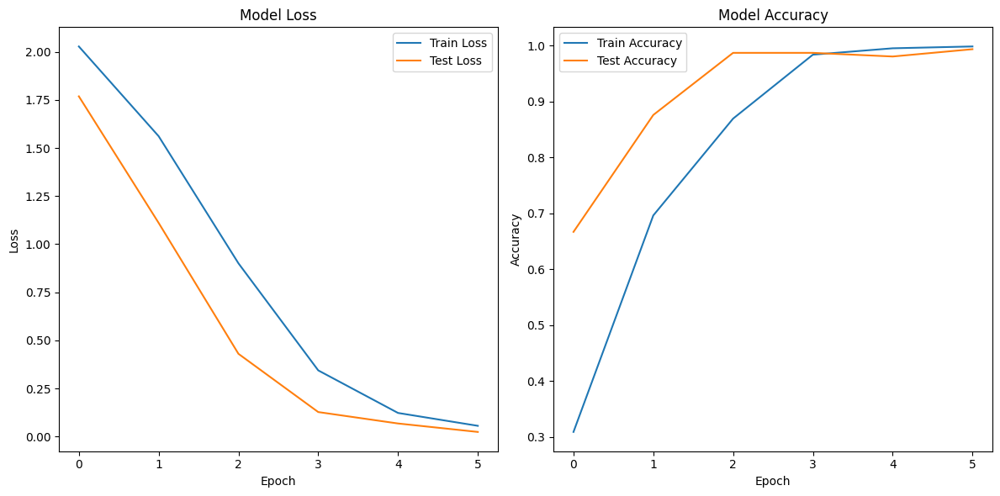

In [105]:
import numpy as np
from tensorflow.keras.utils import to_categorical
import tensorflow as tf

# Mengubah bentuk X_train dan X_test menjadi format yang sesuai untuk LSTM
X_train_reshaped = X_train.reshape(X_train.shape[0]*X_train.shape[1],X_train.shape[2],X_train.shape[4])  # Menggabungkan fitur 38 dan 21 menjadi 798 4, 35, 38 * 21
X_test_reshaped = X_test.reshape(X_test.shape[0]*X_test.shape[1],X_test.shape[2],X_test.shape[4])  # M
# X_train_reshaped = X_train.reshape(4, 35, 38 * 21)  # Menggabungkan fitur 38 dan 21 menjadi 798 4, 35, 38 * 21
# X_test_reshaped = X_test.reshape(4,9, 38* 21)  # Menggabungkan fitur 38 dan 21 menjadi 798

# Mengonversi label ke one-hot encoding (karena menggunakan categorical crossentropy)
y_train_one_hot = to_categorical(y_train, num_classes=9)
y_test_one_hot = to_categorical(y_test, num_classes=9)

model = tf.keras.Sequential([
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64), input_shape=(X_train.shape[2],X_train.shape[4])),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(32, activation='relu'),
    
    tf.keras.layers.Dense(9, activation='softmax')
])


# # Model LSTM untuk klasifikasi multikelas (4 label) dengan return_sequences=True
# model = tf.keras.Sequential([
#     tf.keras.layers.LSTM(32, input_shape=(38, 21)),
#     tf.keras.layers.Dense(16, activation='relu'),
#     tf.keras.layers.Dense(4, activation='softmax')
# ])
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
# Kompilasi model dengan loss function categorical_crossentropy dan metrik accuracy
# model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Menyediakan ringkasan model
model.summary()

# Melatih model
smart_early_stopping = SmartEarlyStopping(target_acc=0.99, target_loss=0.1)

history = model.fit(
    X_train_reshaped, y_train_one_hot,
    epochs=20,
    batch_size=32,
    validation_data=(X_test_reshaped, y_test_one_hot),
    verbose=2,
    shuffle=True,
    callbacks=[smart_early_stopping]
)
# Menampilkan grafik loss dan accuracy
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))

# Grafik Loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Test Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# Grafik Accuracy
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Test Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()


In [106]:
model.save('model/dinamic/1.h5')

In [128]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
import matplotlib.pyplot as plt

# Custom TrustGate Layer
class TrustGate(tf.keras.layers.Layer):
    def __init__(self, units, **kwargs):
        super(TrustGate, self).__init__(**kwargs)
        self.units = units

    def build(self, input_shape):
        self.W_tau = self.add_weight(shape=(input_shape[-1], self.units),
                                     initializer='glorot_uniform',
                                     trainable=True)
        self.b_tau = self.add_weight(shape=(self.units,),
                                     initializer='zeros',
                                     trainable=True)

    def call(self, inputs):
        tau = tf.sigmoid(tf.tensordot(inputs, self.W_tau, axes=1) + self.b_tau)
        return tau * inputs

    def get_config(self):
        config = super(TrustGate, self).get_config()
        config.update({"units": self.units})
        return config

# --- Ubah Bentuk Data Sesuai ---
X_train_reshaped = X_train.reshape(X_train.shape[0]*X_train.shape[1], X_train.shape[2], X_train.shape[4])
X_test_reshaped = X_test.reshape(X_test.shape[0]*X_test.shape[1], X_test.shape[2], X_test.shape[4])

# One-hot encoding
y_train_one_hot = to_categorical(y_train, num_classes=9)
y_test_one_hot = to_categorical(y_test, num_classes=9)

# --- Model dengan TrustGate ---
input_dim = X_train.shape[4]
timesteps = X_train.shape[2]

model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(timesteps, input_dim)),
    TrustGate(units=input_dim),  # Trust Gate Layer
    tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(0.1),
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(9, activation='softmax')
])

# Kompilasi
optimizer = tf.keras.optimizers.Adam(learning_rate=0.0005)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()


smart_early_stopping = SmartEarlyStopping(target_acc=0.99, target_loss=0.1)

history = model.fit(
    X_train_reshaped, y_train_one_hot,
    epochs=20,
    batch_size=32,
    validation_data=(X_test_reshaped, y_test_one_hot),
    verbose=2,
    shuffle=True,
    callbacks=[smart_early_stopping]
)

# Plot grafik hasil
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Test Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Test Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ trust_gate (TrustGate)          │ (None, 25, 46)         │         2,162 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_10                │ (None, 128)            │        56,832 │
│ (Bidirectional)                 │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_10 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 9)              │           297 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 69,627 (271.98 KB)

 Trainable params: 69,627 (271.98 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20


E0000 00:00:1746907891.005097  732033 cuda_blas.cc:193] failed to create cublas handle: the resource allocation failed
E0000 00:00:1746907891.005125  732033 cuda_blas.cc:196] Failure to initialize cublas may be due to OOM (cublas needs some free memory when you initialize it, and your deep-learning framework may have preallocated more than its fair share), or may be because this binary was not built with support for the GPU in your machine.


InternalError: Graph execution error:

Detected at node sequential_10_1/trust_gate_1/Tensordot/MatMul defined at (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main

  File "<frozen runpy>", line 88, in _run_code

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel_launcher.py", line 18, in <module>

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/traitlets/config/application.py", line 1075, in launch_instance

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/kernelapp.py", line 739, in start

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/tornado/platform/asyncio.py", line 205, in start

  File "/usr/lib/python3.12/asyncio/base_events.py", line 641, in run_forever

  File "/usr/lib/python3.12/asyncio/base_events.py", line 1987, in _run_once

  File "/usr/lib/python3.12/asyncio/events.py", line 88, in _run

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/kernelbase.py", line 545, in dispatch_queue

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/kernelbase.py", line 534, in process_one

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/kernelbase.py", line 437, in dispatch_shell

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/ipkernel.py", line 362, in execute_request

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/kernelbase.py", line 778, in execute_request

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/ipkernel.py", line 449, in do_execute

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/ipykernel/zmqshell.py", line 549, in run_cell

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/IPython/core/interactiveshell.py", line 3044, in run_cell

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/IPython/core/interactiveshell.py", line 3099, in _run_cell

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/IPython/core/async_helpers.py", line 128, in _pseudo_sync_runner

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/IPython/core/interactiveshell.py", line 3303, in run_cell_async

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/IPython/core/interactiveshell.py", line 3486, in run_ast_nodes

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/IPython/core/interactiveshell.py", line 3546, in run_code

  File "/tmp/ipykernel_723928/1475422660.py", line 60, in <module>

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/backend/tensorflow/trainer.py", line 371, in fit

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/backend/tensorflow/trainer.py", line 219, in function

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/backend/tensorflow/trainer.py", line 132, in multi_step_on_iterator

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/backend/tensorflow/trainer.py", line 113, in one_step_on_data

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/backend/tensorflow/trainer.py", line 57, in train_step

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/layers/layer.py", line 909, in __call__

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/ops/operation.py", line 52, in __call__

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/utils/traceback_utils.py", line 156, in error_handler

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/models/sequential.py", line 221, in call

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/models/functional.py", line 183, in call

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/ops/function.py", line 171, in _run_through_graph

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/models/functional.py", line 643, in call

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/layers/layer.py", line 909, in __call__

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/utils/traceback_utils.py", line 117, in error_handler

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/ops/operation.py", line 52, in __call__

  File "/home/lalo_salamanca/Projects/p1_project_LSTM/.venv/lib/python3.12/site-packages/keras/src/utils/traceback_utils.py", line 156, in error_handler

  File "/tmp/ipykernel_723928/1475422660.py", line 21, in call

No blas support for stream
	 [[{{node sequential_10_1/trust_gate_1/Tensordot/MatMul}}]] [Op:__inference_multi_step_on_iterator_30446]

1. model_12 = LSTM FUNDAMENTAL range or diff scala each frame like static
2. model_13 = LSTM with Trust gate dropna
3. model_14 = LSRM with interpolate

In [102]:
model.save("model/dinamic/model_12.h5")


In [ ]:
model.input_shape

(None, 22, 26)

In [ ]:
print(model.input_shape)


(None, 35, 798)


In [ ]:
df

,sequence,timestep,label,X0,X1,X2
0,1,0,A,73.199394,15.601864,NaN
1,1,1,A,NaN,60.111501,2.058449
2,1,2,A,83.244264,18.182497,NaN
3,1,3,A,52.475643,29.122914,13.949386
4,1,4,A,36.636184,78.517596,NaN
5,1,5,A,59.241457,NaN,17.052412
6,1,6,A,NaN,96.563203,30.461377
7,1,7,A,NaN,44.015249,NaN
8,1,0,B,17.336465,18.223609,42.515587
9,1,1,B,56.770033,NaN,44.975413


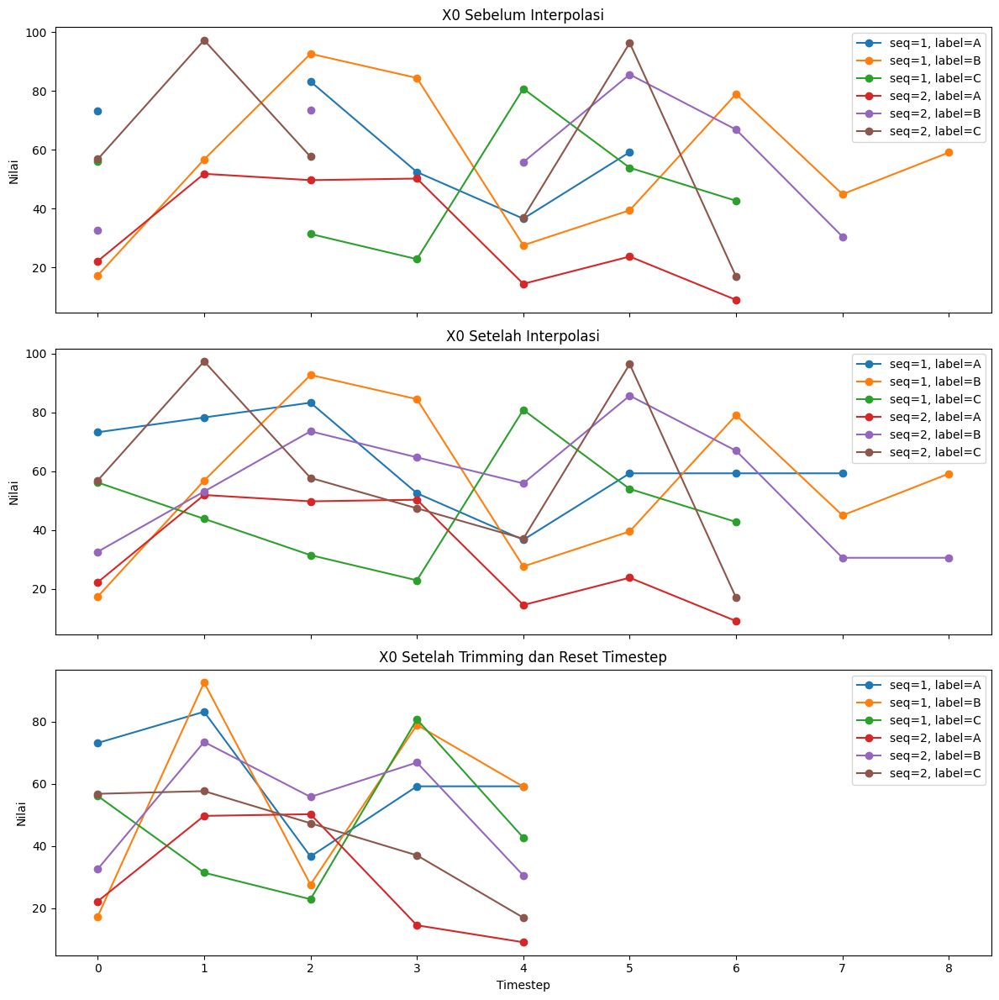

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# -----------------------------
# 1. Generate dummy dataframe
# -----------------------------
np.random.seed(42)
n_features = 3
features = [f'X{i}' for i in range(n_features)]
sequences = [1, 2]
labels = ['A', 'B', 'C']
data = []

for seq in sequences:
    for label in labels:
        n_timesteps = np.random.randint(5, 10)
        for t in range(n_timesteps):
            row = {
                'sequence': seq,
                'timestep': t,
                'label': label
            }
            for f in features:
                row[f] = np.nan if np.random.rand() < 0.2 else np.random.rand() * 100
            data.append(row)

df = pd.DataFrame(data)
df_original = df.copy()  # simpan versi asli

# -----------------------------
# 2. Interpolasi per group
# -----------------------------
df_interpolated = df.copy()
df_interpolated[features] = (
    df.groupby(['sequence', 'label'])[features]
    .apply(lambda group: group.interpolate(method='linear', limit_direction='both'))
    .reset_index(drop=True)
)

# -----------------------------
# 3. Trimming & reset timestep
# -----------------------------
def trim_and_reset_timestep(df, target_length=5):
    trimmed_data = []
    for (seq, label), group in df.groupby(['sequence', 'label']):
        group_sorted = group.sort_values('timestep')
        n = len(group_sorted)
        if n <= target_length:
            trimmed = group_sorted.copy()
        else:
            indices = np.round(np.linspace(0, n - 1, target_length)).astype(int)
            trimmed = group_sorted.iloc[indices].copy()
        trimmed['timestep'] = np.arange(len(trimmed))
        trimmed_data.append(trimmed)
    return pd.concat(trimmed_data).reset_index(drop=True)

df_trimmed = trim_and_reset_timestep(df_interpolated, target_length=5)

# -----------------------------
# 4. Visualisasi
# -----------------------------
feature_to_plot = 'X0'
fig, axes = plt.subplots(3, 1, figsize=(12, 12), sharex=True)

# Sebelum interpolasi
for key, grp in df_original.groupby(['sequence', 'label']):
    axes[0].plot(grp['timestep'], grp[feature_to_plot], marker='o', label=f'seq={key[0]}, label={key[1]}')
axes[0].set_title(f'{feature_to_plot} Sebelum Interpolasi')
axes[0].legend()
axes[0].set_ylabel('Nilai')

# Setelah interpolasi
for key, grp in df_interpolated.groupby(['sequence', 'label']):
    axes[1].plot(grp['timestep'], grp[feature_to_plot], marker='o', label=f'seq={key[0]}, label={key[1]}')
axes[1].set_title(f'{feature_to_plot} Setelah Interpolasi')
axes[1].legend()
axes[1].set_ylabel('Nilai')

# Setelah trimming dan reset timestep
for key, grp in df_trimmed.groupby(['sequence', 'label']):
    axes[2].plot(grp['timestep'], grp[feature_to_plot], marker='o', label=f'seq={key[0]}, label={key[1]}')
axes[2].set_title(f'{feature_to_plot} Setelah Trimming dan Reset Timestep')
axes[2].legend()
axes[2].set_xlabel('Timestep')
axes[2].set_ylabel('Nilai')

plt.tight_layout()
plt.show()


In [ ]:
pd.read_csv("csv/dinamic/raw.csv")

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34999,0.260127,0.275204,0.308674,0.321435,0.307485,0.344711,0.427956,0.408890,0.380329,0.349681,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
35000,0.257383,0.270302,0.302789,0.315210,0.300283,0.338908,0.421985,0.403143,0.374593,0.344900,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
35001,0.253509,0.266026,0.297492,0.309809,0.294551,0.333265,0.414466,0.396999,0.369707,0.340223,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
35002,0.248450,0.258652,0.289564,0.303354,0.289962,0.328215,0.409235,0.392639,0.365836,0.334386,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [22]:
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
z_cols = [f'Z{i}' for i in range(21)]
df = pd.read_csv("csv/dinamic/raw.csv")
def reset_timestep(group):
    group = group.sort_values('timestep').copy()
    group['timestep'] = np.arange(0, len(group) )
    return group
df[x_cols + y_cols+z_cols] = (
    df.groupby(['sequence', 'Label'])[x_cols + y_cols+z_cols]
      .transform(lambda group: group.interpolate(method='linear', limit_direction='both'))
)
df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)
df

/tmp/ipykernel_99858/3603827252.py:13: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34999,0.260127,0.275204,0.308674,0.321435,0.307485,0.344711,0.427956,0.408890,0.380329,0.349681,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
35000,0.257383,0.270302,0.302789,0.315210,0.300283,0.338908,0.421985,0.403143,0.374593,0.344900,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
35001,0.253509,0.266026,0.297492,0.309809,0.294551,0.333265,0.414466,0.396999,0.369707,0.340223,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
35002,0.248450,0.258652,0.289564,0.303354,0.289962,0.328215,0.409235,0.392639,0.365836,0.334386,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [1]:
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
z_cols = [f'Z{i}' for i in range(21)]
df = pd.read_csv("csv/dinamic/raw.csv")
df = df.dropna(subset=x_cols + y_cols)
df

NameError: name 'pd' is not defined

In [ ]:
df.iloc[20:30]

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
21,0.299759,0.350038,0.380459,0.387147,0.362835,0.351094,0.354957,0.362647,0.365475,0.307209,...,-0.108045,-0.106416,-0.103960,-0.081830,-0.100263,-0.097926,-0.095726,21,z,0
22,0.305837,0.360706,0.392748,0.402768,0.378605,0.365479,0.369708,0.381450,0.386484,0.322331,...,-0.106671,-0.099066,-0.093623,-0.085284,-0.102218,-0.098665,-0.095384,22,z,0
23,0.316811,0.365136,0.396474,0.409987,0.393644,0.375758,0.386054,0.395396,0.398539,0.330680,...,-0.111951,-0.103420,-0.095677,-0.091260,-0.106542,-0.099278,-0.092622,23,z,0
24,0.327623,0.374898,0.408612,0.420856,0.397350,0.389220,0.397426,0.406725,0.407121,0.341407,...,-0.122607,-0.107572,-0.098169,-0.104986,-0.122622,-0.115937,-0.110928,24,z,0
25,0.323395,0.372804,0.408101,0.417681,0.395708,0.385710,0.393060,0.400406,0.399464,0.339374,...,-0.111308,-0.100014,-0.092388,-0.095469,-0.111834,-0.105842,-0.101091,25,z,0
28,0.290043,0.331869,0.357771,0.341486,0.313091,0.347701,0.298281,0.292708,0.297266,0.304653,...,-0.119653,-0.115643,-0.108290,-0.073785,-0.104397,-0.104924,-0.100692,28,z,0
29,0.291077,0.311529,0.314021,0.289024,0.257693,0.345850,0.289123,0.262878,0.252400,0.319361,...,-0.105110,-0.102929,-0.096542,-0.064801,-0.092074,-0.092299,-0.087230,29,z,0
30,0.267060,0.283498,0.281440,0.239569,0.198841,0.314122,0.270399,0.246131,0.228849,0.284302,...,-0.107738,-0.106561,-0.100072,-0.065902,-0.093291,-0.090500,-0.081008,30,z,0
31,0.255867,0.280294,0.282467,0.243294,0.205226,0.290526,0.238575,0.206017,0.180262,0.257277,...,-0.103056,-0.105464,-0.101784,-0.061593,-0.092185,-0.095735,-0.090984,31,z,0
32,0.265513,0.283766,0.272780,0.224109,0.178453,0.272649,0.201225,0.154964,0.120940,0.246814,...,-0.085970,-0.087197,-0.086445,-0.051416,-0.069430,-0.066215,-0.059799,32,z,0


In [3]:
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
z_cols = [f'Z{i}' for i in range(21)]
df = pd.read_csv("csv/dinamic/raw.csv")
df = df.dropna(subset=x_cols + y_cols)
def reset_timestep(group):
    group = group.sort_values('timestep').copy()
    group['timestep'] = np.arange(0, len(group) )
    return group

df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)
df

/tmp/ipykernel_4499/3487157248.py:11: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.349613,0.395903,0.428723,0.434223,0.414144,0.408765,0.417041,0.419970,0.420736,0.368689,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.351053,0.396507,0.430004,0.437134,0.417371,0.410775,0.419671,0.422106,0.422784,0.370238,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.348228,0.395245,0.429668,0.438338,0.418407,0.411904,0.420998,0.423716,0.423909,0.372446,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.347149,0.396180,0.431006,0.439432,0.419200,0.413089,0.420963,0.424718,0.426242,0.374475,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.350261,0.397619,0.432674,0.439380,0.417586,0.410478,0.421872,0.425194,0.426137,0.370700,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33378,0.260127,0.275204,0.308674,0.321435,0.307485,0.344711,0.427956,0.408890,0.380329,0.349681,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
33379,0.257383,0.270302,0.302789,0.315210,0.300283,0.338908,0.421985,0.403143,0.374593,0.344900,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
33380,0.253509,0.266026,0.297492,0.309809,0.294551,0.333265,0.414466,0.396999,0.369707,0.340223,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
33381,0.248450,0.258652,0.289564,0.303354,0.289962,0.328215,0.409235,0.392639,0.365836,0.334386,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [ ]:
import pandas as pd

# Misalnya df adalah dataframe kamu
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
feature_cols = x_cols + y_cols

# Hitung selisih antar timestep untuk setiap group Label dan sequence
df_diff = df.copy()
df_diff[feature_cols] = df.groupby(['Label', 'sequence'])[feature_cols].diff()

# Hasil df_diff akan berisi nilai (timestep_n - timestep_n-1) untuk tiap kolom fitur


In [54]:
df_diff = df_diff.dropna(subset=x_cols + y_cols)
df_diff = df_diff.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)
df_diff.to_csv('csv/dinamic/diff1.csv',index=False)

/tmp/ipykernel_99858/1965248131.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_diff = df_diff.groupby(['sequence', 'Label'], group_keys=False).apply(reset_timestep).reset_index(drop=True)


In [ ]:
df.isna().sum()

X0          0
X1          0
X2          0
X3          0
X4          0
           ..
Z19         0
Z20         0
timestep    0
Label       0
sequence    0
Length: 66, dtype: int64

In [ ]:
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
x_cols+y_cols 

['X0',
 'X1',
 'X2',
 'X3',
 'X4',
 'X5',
 'X6',
 'X7',
 'X8',
 'X9',
 'X10',
 'X11',
 'X12',
 'X13',
 'X14',
 'X15',
 'X16',
 'X17',
 'X18',
 'X19',
 'X20',
 'Y0',
 'Y1',
 'Y2',
 'Y3',
 'Y4',
 'Y5',
 'Y6',
 'Y7',
 'Y8',
 'Y9',
 'Y10',
 'Y11',
 'Y12',
 'Y13',
 'Y14',
 'Y15',
 'Y16',
 'Y17',
 'Y18',
 'Y19',
 'Y20']

/tmp/ipykernel_5020/3842738443.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('tab10',30)


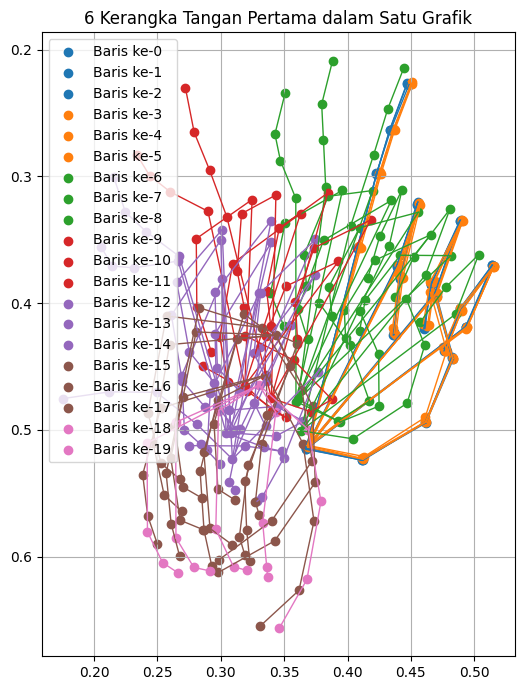

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
# Misal data sudah ada di df
df = pd.read_csv("csv_separated/dinamic/raw/j.csv")

# Ambil hanya 3 baris pertama
df_subset = df.iloc[:30]

# Koneksi antar titik (MediaPipe Hand)
connections = [
    (0, 1), (1, 2), (2, 3), (3, 4),
    (0, 5), (5, 6), (6, 7), (7, 8),
    (0, 9), (9, 10), (10, 11), (11, 12),
    (0, 13), (13, 14), (14, 15), (15, 16),
    (0, 17), (17, 18), (18, 19), (19, 20)
]

# Buat figure
plt.figure(figsize=(7, 7))

# Ambil 6 warna dari colormap 'tab10'
colors = cm.get_cmap('tab10',30)

# Plot semua kerangka dalam satu grafik
for i in range(20):
    x = [df_subset.iloc[i][f'X{j}'] for j in range(21)]
    y = [df_subset.iloc[i][f'Y{j}'] for j in range(21)]

    # Plot titik
    plt.scatter(x, y, color=colors(i), label=f'Baris ke-{i}')

    # Plot garis kerangka
    for start, end in connections:
        plt.plot([x[start], x[end]], [y[start], y[end]], color=colors(i), linewidth=1)

# Format tampilan
plt.title("6 Kerangka Tangan Pertama dalam Satu Grafik")
plt.gca().invert_yaxis()
plt.gca().set_aspect('equal')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

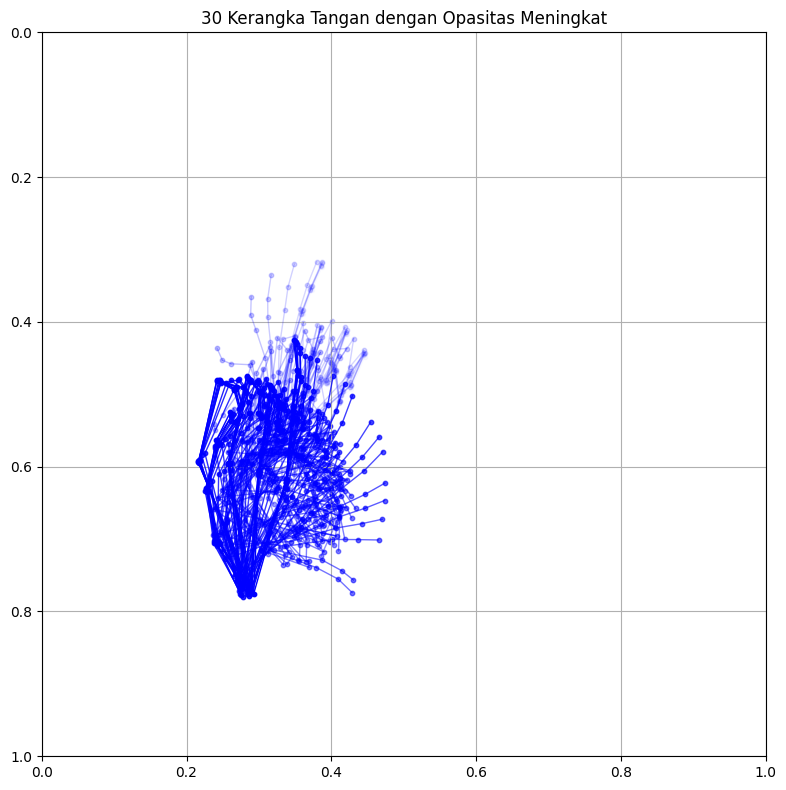

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data

df =df[(df['sequence']==21)&(df['Label']=='j')]
df_subset = df.iloc[:]  # Ambil 30 baris pertama

# Koneksi titik berdasarkan MediaPipe Hand
connections = [
    (0, 1), (1, 2), (2, 3), (3, 4),
    (0, 5), (5, 6), (6, 7), (7, 8),
    (0, 9), (9, 10), (10, 11), (11, 12),
    (0, 13), (13, 14), (14, 15), (15, 16),
    (0, 17), (17, 18), (18, 19), (19, 20)
]

# Buat figure
plt.figure(figsize=(8, 8))

# Warna dasar (misalnya biru tua)
base_color = 'blue'

# Plot semua kerangka dalam satu grafik
for i in range(len(df_subset)):
    x = [df_subset.iloc[i][f'X{j}'] for j in range(21)]
    y = [df_subset.iloc[i][f'Y{j}'] for j in range(21)]

    alpha_value = (i + 1) / len(df_subset)  # Dari 1/30 hingga 30/30 (semakin tinggi i, semakin tebal)

    # Plot titik
    plt.scatter(x, y, color=base_color, alpha=alpha_value, s=10)

    # Plot garis koneksi
    for start, end in connections:
        plt.plot([x[start], x[end]], [y[start], y[end]],
                 color=base_color, alpha=alpha_value, linewidth=1)

# Format tampilan
plt.xlim(0, 1)
plt.ylim(0, 1)
plt.title("30 Kerangka Tangan dengan Opasitas Meningkat")
plt.gca().invert_yaxis()
plt.gca().set_aspect('equal')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
df.iloc[20:30]


,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
20,0.299759,0.350038,0.380459,0.387147,0.362835,0.351094,0.354957,0.362647,0.365475,0.307209,...,-0.108045,-0.106416,-0.103960,-0.081830,-0.100263,-0.097926,-0.095726,20,z,0
21,0.305837,0.360706,0.392748,0.402768,0.378605,0.365479,0.369708,0.381450,0.386484,0.322331,...,-0.106671,-0.099066,-0.093623,-0.085284,-0.102218,-0.098665,-0.095384,21,z,0
22,0.316811,0.365136,0.396474,0.409987,0.393644,0.375758,0.386054,0.395396,0.398539,0.330680,...,-0.111951,-0.103420,-0.095677,-0.091260,-0.106542,-0.099278,-0.092622,22,z,0
23,0.327623,0.374898,0.408612,0.420856,0.397350,0.389220,0.397426,0.406725,0.407121,0.341407,...,-0.122607,-0.107572,-0.098169,-0.104986,-0.122622,-0.115937,-0.110928,23,z,0
24,0.323395,0.372804,0.408101,0.417681,0.395708,0.385710,0.393060,0.400406,0.399464,0.339374,...,-0.111308,-0.100014,-0.092388,-0.095469,-0.111834,-0.105842,-0.101091,24,z,0
25,0.290043,0.331869,0.357771,0.341486,0.313091,0.347701,0.298281,0.292708,0.297266,0.304653,...,-0.119653,-0.115643,-0.108290,-0.073785,-0.104397,-0.104924,-0.100692,25,z,0
26,0.291077,0.311529,0.314021,0.289024,0.257693,0.345850,0.289123,0.262878,0.252400,0.319361,...,-0.105110,-0.102929,-0.096542,-0.064801,-0.092074,-0.092299,-0.087230,26,z,0
27,0.267060,0.283498,0.281440,0.239569,0.198841,0.314122,0.270399,0.246131,0.228849,0.284302,...,-0.107738,-0.106561,-0.100072,-0.065902,-0.093291,-0.090500,-0.081008,27,z,0
28,0.255867,0.280294,0.282467,0.243294,0.205226,0.290526,0.238575,0.206017,0.180262,0.257277,...,-0.103056,-0.105464,-0.101784,-0.061593,-0.092185,-0.095735,-0.090984,28,z,0
29,0.265513,0.283766,0.272780,0.224109,0.178453,0.272649,0.201225,0.154964,0.120940,0.246814,...,-0.085970,-0.087197,-0.086445,-0.051416,-0.069430,-0.066215,-0.059799,29,z,0


In [5]:
# Ambil kolom X0–X20 dan Y0–Y20
x_cols = [f'X{i}' for i in range(21)]
y_cols = [f'Y{i}' for i in range(21)]
def subtract_min_from_first_row(group):
    # Ambil nilai minimum dari baris pertama dalam grup, per kolom
    xmin = group[x_cols].iloc[0].min()
    ymin = group[y_cols].iloc[0].min()
    
    # Kurangkan seluruh kolom X dan Y di grup ini dengan min tersebut
    group[x_cols] = group[x_cols] - xmin
    group[y_cols] = group[y_cols] - ymin
    return group

# Terapkan ke seluruh DataFrame
df_subset = df.copy()
df_subset = df_subset.groupby(['Label', 'sequence'], group_keys=False).apply(subtract_min_from_first_row)


/tmp/ipykernel_4356/3446555475.py:16: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_subset = df_subset.groupby(['Label', 'sequence'], group_keys=False).apply(subtract_min_from_first_row)


In [ ]:
df_subset[(df_subset['Label']=='j' )& (df_subset['sequence']==1)][x_cols]

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X11,X12,X13,X14,X15,X16,X17,X18,X19,X20
3818,0.000000,0.035967,0.075506,0.092422,0.087987,0.116451,0.137365,0.116772,0.102688,0.091687,...,0.090175,0.085244,0.061913,0.070833,0.055539,0.050883,0.031353,0.047459,0.057599,0.071366
3819,0.001100,0.037043,0.075701,0.091430,0.085868,0.117697,0.137632,0.117776,0.103726,0.092436,...,0.090316,0.084578,0.062369,0.070684,0.056166,0.051414,0.031773,0.047445,0.057300,0.070687
3820,0.000418,0.037521,0.075046,0.090222,0.084378,0.117181,0.136737,0.118075,0.104462,0.092206,...,0.092373,0.088601,0.062500,0.070620,0.057271,0.052804,0.032158,0.047561,0.058134,0.071924
3821,-0.001100,0.037615,0.075626,0.090332,0.083843,0.116380,0.136423,0.114017,0.099626,0.091595,...,0.088656,0.083552,0.061691,0.071058,0.057486,0.053587,0.031223,0.046085,0.057002,0.071121
3822,-0.000214,0.037262,0.075078,0.087983,0.081280,0.115435,0.134825,0.113322,0.098448,0.091241,...,0.088221,0.081612,0.060972,0.069905,0.056096,0.050972,0.029124,0.045791,0.055765,0.067572
3823,0.000806,0.037824,0.073868,0.083459,0.075469,0.112617,0.132412,0.114548,0.100030,0.087569,...,0.086481,0.078730,0.057397,0.062067,0.048718,0.043342,0.025652,0.040565,0.050015,0.061583
3824,0.000187,0.038000,0.070493,0.077193,0.065414,0.114056,0.120601,0.097681,0.086453,0.086044,...,0.062945,0.059771,0.054030,0.048090,0.034381,0.033364,0.022091,0.032668,0.039176,0.050272
3825,0.003313,0.045569,0.072357,0.066812,0.041529,0.101371,0.100487,0.087269,0.079761,0.069756,...,0.046108,0.043054,0.036040,0.027054,0.019607,0.019962,0.002416,-0.000324,-0.000815,0.003406
3826,0.003430,0.044020,0.071205,0.055384,0.025465,0.088673,0.093262,0.085202,0.078431,0.056181,...,0.046576,0.044325,0.022936,0.019772,0.014888,0.015180,-0.010523,-0.016532,-0.022324,-0.023492
3827,-0.001640,0.032583,0.055545,0.038487,0.010043,0.069553,0.066868,0.054841,0.050409,0.033055,...,0.014903,0.015677,-0.002934,-0.014585,-0.018350,-0.011694,-0.035264,-0.054550,-0.063303,-0.062320


In [27]:
df_trimmed

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.059239,0.102984,0.118509,0.112666,0.105535,0.083249,0.090799,0.099916,0.096383,0.054632,...,-0.052240,-0.045953,-0.034717,-0.028496,-0.050127,-0.044169,-0.035163,0,10,0
1,0.061281,0.103821,0.119444,0.113909,0.106211,0.082875,0.090037,0.098926,0.094463,0.054449,...,-0.052695,-0.046044,-0.034578,-0.028170,-0.049896,-0.043894,-0.034844,1,10,0
2,0.062233,0.105003,0.120293,0.114576,0.107846,0.083345,0.092837,0.102002,0.097017,0.054344,...,-0.052340,-0.046002,-0.034962,-0.028974,-0.049954,-0.043566,-0.034429,2,10,0
3,0.064779,0.108328,0.124196,0.118981,0.111939,0.088786,0.095632,0.104306,0.100487,0.059634,...,-0.050342,-0.044451,-0.033741,-0.027941,-0.048346,-0.041917,-0.032911,3,10,0
4,0.065552,0.111879,0.129212,0.122988,0.115001,0.093391,0.102138,0.109864,0.106221,0.064118,...,-0.044304,-0.041043,-0.033564,-0.026560,-0.045084,-0.040917,-0.034320,4,10,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17995,-0.038839,0.024279,0.060967,0.061328,0.037241,0.011588,0.023325,0.032340,0.031073,-0.028795,...,-0.068792,-0.064983,-0.062463,-0.057179,-0.068003,-0.062446,-0.058246,20,z,79
17996,-0.057044,0.000610,0.039104,0.038995,0.012383,-0.016160,0.003711,0.006651,-0.000737,-0.050710,...,-0.060812,-0.060095,-0.060668,-0.044538,-0.058545,-0.058450,-0.058877,21,z,79
17997,-0.068311,-0.093697,-0.099239,-0.088892,-0.072123,-0.043636,-0.029481,-0.039314,-0.049572,-0.015594,...,-0.072504,-0.074700,-0.074399,-0.051168,-0.070127,-0.071090,-0.069704,22,z,79
17998,-0.096540,-0.130931,-0.136806,-0.111047,-0.075681,-0.068611,-0.048357,-0.069472,-0.089522,-0.034048,...,-0.086607,-0.085883,-0.079542,-0.053267,-0.077745,-0.077866,-0.073921,23,z,79


In [ ]:
df[(df['Label']=='j' )& (df['sequence']==1)][x_cols] - df[(df['Label']=='j' )& (df['sequence']==1)][x_cols].iloc[0].min()

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X11,X12,X13,X14,X15,X16,X17,X18,X19,X20
3818,0.000000,0.035967,0.075506,0.092422,0.087987,0.116451,0.137365,0.116772,0.102688,0.091687,...,0.090175,0.085244,0.061913,0.070833,0.055539,0.050883,0.031353,0.047459,0.057599,0.071366
3819,0.001100,0.037043,0.075701,0.091430,0.085868,0.117697,0.137632,0.117776,0.103726,0.092436,...,0.090316,0.084578,0.062369,0.070684,0.056166,0.051414,0.031773,0.047445,0.057300,0.070687
3820,0.000418,0.037521,0.075046,0.090222,0.084378,0.117181,0.136737,0.118075,0.104462,0.092206,...,0.092373,0.088601,0.062500,0.070620,0.057271,0.052804,0.032158,0.047561,0.058134,0.071924
3821,-0.001100,0.037615,0.075626,0.090332,0.083843,0.116380,0.136423,0.114017,0.099626,0.091595,...,0.088656,0.083552,0.061691,0.071058,0.057486,0.053587,0.031223,0.046085,0.057002,0.071121
3822,-0.000214,0.037262,0.075078,0.087983,0.081280,0.115435,0.134825,0.113322,0.098448,0.091241,...,0.088221,0.081612,0.060972,0.069905,0.056096,0.050972,0.029124,0.045791,0.055765,0.067572
3823,0.000806,0.037824,0.073868,0.083459,0.075469,0.112617,0.132412,0.114548,0.100030,0.087569,...,0.086481,0.078730,0.057397,0.062067,0.048718,0.043342,0.025652,0.040565,0.050015,0.061583
3824,0.000187,0.038000,0.070493,0.077193,0.065414,0.114056,0.120601,0.097681,0.086453,0.086044,...,0.062945,0.059771,0.054030,0.048090,0.034381,0.033364,0.022091,0.032668,0.039176,0.050272
3825,0.003313,0.045569,0.072357,0.066812,0.041529,0.101371,0.100487,0.087269,0.079761,0.069756,...,0.046108,0.043054,0.036040,0.027054,0.019607,0.019962,0.002416,-0.000324,-0.000815,0.003406
3826,0.003430,0.044020,0.071205,0.055384,0.025465,0.088673,0.093262,0.085202,0.078431,0.056181,...,0.046576,0.044325,0.022936,0.019772,0.014888,0.015180,-0.010523,-0.016532,-0.022324,-0.023492
3827,-0.001640,0.032583,0.055545,0.038487,0.010043,0.069553,0.066868,0.054841,0.050409,0.033055,...,0.014903,0.015677,-0.002934,-0.014585,-0.018350,-0.011694,-0.035264,-0.054550,-0.063303,-0.062320


In [ ]:
df_subset

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.050596,0.096886,0.129706,0.135206,0.115127,0.109748,0.118024,0.120952,0.121718,0.069672,...,-0.084476,-0.081479,-0.074319,-0.060002,-0.081880,-0.078741,-0.073448,0,z,0
1,0.052036,0.097490,0.130987,0.138117,0.118354,0.111758,0.120654,0.123089,0.123767,0.071221,...,-0.084855,-0.081324,-0.073809,-0.061057,-0.082972,-0.079422,-0.073684,1,z,0
2,0.049211,0.096228,0.130651,0.139321,0.119390,0.112887,0.121981,0.124699,0.124892,0.073429,...,-0.086759,-0.083269,-0.075242,-0.060964,-0.084612,-0.081654,-0.075855,2,z,0
3,0.048132,0.097163,0.131989,0.140415,0.120183,0.114072,0.121946,0.125701,0.127225,0.075458,...,-0.085307,-0.083170,-0.076024,-0.059474,-0.082815,-0.080836,-0.075877,3,z,0
4,0.051244,0.098602,0.133657,0.140363,0.118569,0.111461,0.122855,0.126177,0.127120,0.071683,...,-0.085164,-0.082890,-0.076153,-0.060666,-0.082868,-0.080241,-0.075320,4,z,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34523,-0.104080,-0.089002,-0.055533,-0.042771,-0.056722,-0.019496,0.063749,0.044683,0.016122,-0.014526,...,-0.047926,-0.032301,-0.024548,-0.060770,-0.058005,-0.045811,-0.038729,51,menang,79
34524,-0.106823,-0.093905,-0.061417,-0.048997,-0.063924,-0.025298,0.057778,0.038936,0.010387,-0.019307,...,-0.046909,-0.031539,-0.024506,-0.060897,-0.057524,-0.044973,-0.037996,52,menang,79
34525,-0.110698,-0.098180,-0.066715,-0.054397,-0.069655,-0.030941,0.050259,0.032792,0.005501,-0.023983,...,-0.046081,-0.031622,-0.024784,-0.058408,-0.056349,-0.044901,-0.038347,53,menang,79
34526,-0.115757,-0.105554,-0.074643,-0.060853,-0.074244,-0.035991,0.045028,0.028433,0.001630,-0.029821,...,-0.048279,-0.033019,-0.025999,-0.061434,-0.058841,-0.046805,-0.040195,54,menang,79


In [45]:
def trim_and_reset_timestep(df, target_length=5):
    trimmed_data = []
    for (seq, label), group in df.groupby(['sequence', 'Label']):
        group_sorted = group.sort_values('timestep')
        n = len(group_sorted)
        if n <= target_length:
            trimmed = group_sorted.copy()
        else:
            indices = np.round(np.linspace(0, n - 1, target_length)).astype(int)
            trimmed = group_sorted.iloc[indices].copy()
        trimmed['timestep'] = np.arange(len(trimmed))
        trimmed_data.append(trimmed)
    return pd.concat(trimmed_data).reset_index(drop=True)
df = pd.read_csv("csv/dinamic/filter.csv")
df_trimmed = trim_and_reset_timestep(df, target_length=25)


In [46]:
df_trimmed

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,diffX16,diffY16,diffX17,diffY17,diffX18,diffY18,diffX19,diffY19,diffX20,diffY20
0,0.438141,0.761683,0.876513,0.833296,0.780554,0.615720,0.671561,0.738994,0.712865,0.404064,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.452861,0.767492,0.883043,0.842105,0.785169,0.612571,0.665540,0.731287,0.698277,0.402328,...,-0.000523,-0.000344,0.000017,0.000019,-0.000445,-0.000405,-0.000397,-0.000088,-0.000304,0.000018
2,0.462491,0.778826,0.891909,0.849623,0.799851,0.618636,0.688842,0.756626,0.719757,0.404139,...,-0.000351,-0.000066,-0.000137,-0.000902,0.000758,0.000738,0.000500,0.001122,0.000010,0.000554
3,0.449350,0.771448,0.888808,0.850235,0.798150,0.626911,0.677544,0.741698,0.713453,0.411297,...,0.002324,0.000544,0.002536,0.001996,0.001266,0.000770,0.000508,-0.000827,0.000441,-0.000808
4,0.417013,0.759651,0.887847,0.841815,0.782743,0.622912,0.687604,0.744747,0.717802,0.406405,...,0.007966,0.001372,0.005145,0.003160,0.002766,0.004845,0.005482,0.001161,0.012203,0.006420
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17995,0.304142,0.770974,1.042322,1.044995,0.866842,0.677106,0.763919,0.830594,0.821223,0.378428,...,-0.004232,-0.001717,-0.008936,0.004835,0.009417,0.025238,0.006364,0.019244,-0.003681,0.004409
17996,0.245934,0.672351,0.957061,0.956255,0.759429,0.548317,0.695286,0.717034,0.662394,0.292784,...,-0.016657,-0.007194,-0.001089,0.002961,-0.005230,-0.005693,-0.007490,-0.004855,-0.007814,-0.006304
17997,0.228745,0.040990,0.000000,0.076526,0.200550,0.411244,0.515941,0.443210,0.367345,0.618646,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
17998,0.297812,0.043449,0.000000,0.190516,0.452088,0.504384,0.654179,0.498015,0.349716,0.760009,...,-0.006382,-0.002066,-0.000976,0.000110,-0.008863,0.001993,-0.009918,0.002627,-0.004517,0.001636


In [25]:
df_trimmed[(df_trimmed['Label']=='j' )& (df_trimmed['sequence']==1)][x_cols]

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X11,X12,X13,X14,X15,X16,X17,X18,X19,X20
275,0.000000,0.035967,0.075506,0.092422,0.087987,0.116451,0.137365,0.116772,0.102688,0.091687,...,0.090175,0.085244,0.061913,0.070833,0.055539,0.050883,0.031353,0.047459,0.057599,0.071366
276,0.000418,0.037521,0.075046,0.090222,0.084378,0.117181,0.136737,0.118075,0.104462,0.092206,...,0.092373,0.088601,0.062500,0.070620,0.057271,0.052804,0.032158,0.047561,0.058134,0.071924
277,-0.000214,0.037262,0.075078,0.087983,0.081280,0.115435,0.134825,0.113322,0.098448,0.091241,...,0.088221,0.081612,0.060972,0.069905,0.056096,0.050972,0.029124,0.045791,0.055765,0.067572
278,0.000187,0.038000,0.070493,0.077193,0.065414,0.114056,0.120601,0.097681,0.086453,0.086044,...,0.062945,0.059771,0.054030,0.048090,0.034381,0.033364,0.022091,0.032668,0.039176,0.050272
279,0.003430,0.044020,0.071205,0.055384,0.025465,0.088673,0.093262,0.085202,0.078431,0.056181,...,0.046576,0.044325,0.022936,0.019772,0.014888,0.015180,-0.010523,-0.016532,-0.022324,-0.023492
280,-0.001640,0.032583,0.055545,0.038487,0.010043,0.069553,0.066868,0.054841,0.050409,0.033055,...,0.014903,0.015677,-0.002934,-0.014585,-0.018350,-0.011694,-0.035264,-0.054550,-0.063303,-0.062320
281,-0.007539,0.023229,0.034288,0.009239,-0.022927,0.039262,0.027645,0.016962,0.018291,0.001870,...,-0.009798,-0.000390,-0.030596,-0.039518,-0.035384,-0.023523,-0.053696,-0.077585,-0.086866,-0.087363
282,-0.028154,0.011731,0.033514,0.024093,0.001967,0.031246,0.025307,0.018359,0.019691,-0.006896,...,-0.006714,0.000101,-0.041045,-0.040699,-0.033660,-0.022307,-0.067258,-0.073814,-0.073649,-0.068759
283,-0.048769,0.000233,0.032741,0.038947,0.026860,0.023230,0.022969,0.019755,0.021091,-0.015662,...,-0.003631,0.000593,-0.051493,-0.041881,-0.031937,-0.021091,-0.080821,-0.070043,-0.060431,-0.050156
284,-0.060786,-0.014487,0.025046,0.041927,0.039376,0.013161,0.033433,0.029160,0.024709,-0.020245,...,0.006737,0.004741,-0.050334,-0.024585,-0.019112,-0.015979,-0.074663,-0.053550,-0.043501,-0.035705


In [ ]:
df_trimmed.to

In [83]:
df_trimmed.to_csv('csv/dinamic/filter23.csv',index=False)

In [ ]:
df_trimmed

,X0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,Z14,Z15,Z16,Z17,Z18,Z19,Z20,timestep,Label,sequence
0,0.056769,0.100514,0.116040,0.110197,0.103066,0.080779,0.088329,0.097446,0.093914,0.052162,...,-0.052240,-0.045953,-0.034717,-0.028496,-0.050127,-0.044169,-0.035163,0,10,0
1,0.058812,0.101351,0.116975,0.111439,0.103741,0.080405,0.087567,0.096456,0.091993,0.051979,...,-0.052695,-0.046044,-0.034578,-0.028170,-0.049896,-0.043894,-0.034844,1,10,0
2,0.059763,0.102534,0.117823,0.112106,0.105376,0.080875,0.090367,0.099532,0.094547,0.051874,...,-0.052340,-0.046002,-0.034962,-0.028974,-0.049954,-0.043566,-0.034429,2,10,0
3,0.062309,0.105859,0.121726,0.116511,0.109469,0.086316,0.093162,0.101836,0.098017,0.057164,...,-0.050342,-0.044451,-0.033741,-0.027941,-0.048346,-0.041917,-0.032911,3,10,0
4,0.063083,0.109409,0.126742,0.120518,0.112531,0.090921,0.099668,0.107394,0.103751,0.061648,...,-0.044304,-0.041043,-0.033564,-0.026560,-0.045084,-0.040917,-0.034320,4,10,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17995,-0.051932,0.006723,0.043442,0.045109,0.018212,0.000475,0.002111,0.009166,0.011553,-0.041428,...,-0.076665,-0.076880,-0.075348,-0.064371,-0.075980,-0.071663,-0.067514,20,z,79
17996,-0.077468,-0.018959,0.016355,0.019046,-0.000309,-0.036136,-0.014758,-0.004725,-0.010069,-0.072967,...,-0.072212,-0.070079,-0.069337,-0.056182,-0.069640,-0.066486,-0.064373,21,z,79
17997,-0.097546,-0.122931,-0.128473,-0.118127,-0.101358,-0.072871,-0.058715,-0.068549,-0.078806,-0.044829,...,-0.072504,-0.074700,-0.074399,-0.051168,-0.070127,-0.071090,-0.069704,22,z,79
17998,-0.125775,-0.160166,-0.166041,-0.140282,-0.104916,-0.097845,-0.077592,-0.098706,-0.118757,-0.063283,...,-0.086607,-0.085883,-0.079542,-0.053267,-0.077745,-0.077866,-0.073921,23,z,79


In [ ]:
df_trimmed.to_csv('csv/dinamic/filter2.csv',index=False)

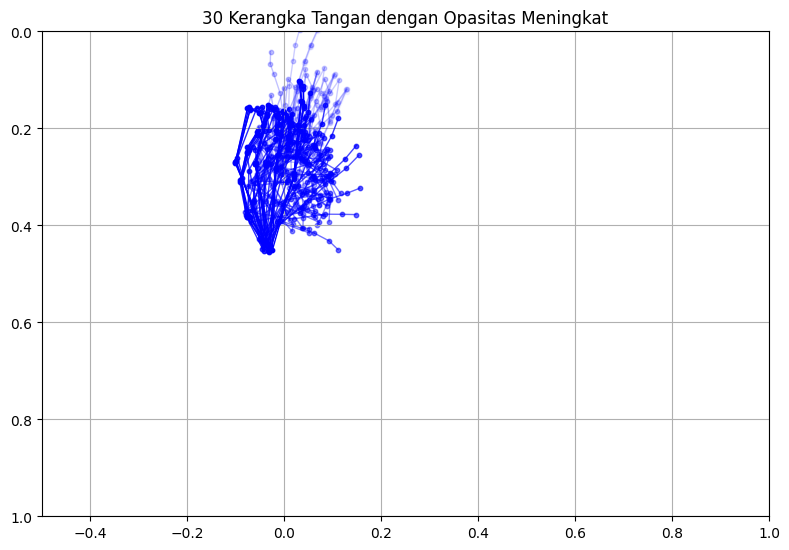

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data
df_subset= df_trimmed[(df_trimmed['Label']=='j')&(df_trimmed['sequence']==21)]
# Koneksi titik berdasarkan MediaPipe Hand
connections = [
    (0, 1), (1, 2), (2, 3), (3, 4),
    (0, 5), (5, 6), (6, 7), (7, 8),
    (0, 9), (9, 10), (10, 11), (11, 12),
    (0, 13), (13, 14), (14, 15), (15, 16),
    (0, 17), (17, 18), (18, 19), (19, 20)
]

# Buat figure
plt.figure(figsize=(8, 8))

# Warna dasar (misalnya biru tua)
base_color = 'blue'

# Plot semua kerangka dalam satu grafik
for i in range(len(df_subset)):
    x = [df_subset.iloc[i][f'X{j}'] for j in range(21)]
    y = [df_subset.iloc[i][f'Y{j}'] for j in range(21)]

    alpha_value = (i + 1) / len(df_subset)  # Dari 1/30 hingga 30/30 (semakin tinggi i, semakin tebal)

    # Plot titik
    plt.scatter(x, y, color=base_color, alpha=alpha_value, s=10)

    # Plot garis koneksi
    for start, end in connections:
        plt.plot([x[start], x[end]], [y[start], y[end]],
                 color=base_color, alpha=alpha_value, linewidth=1)

# Format tampilan
plt.xlim(-0.5, 1)
plt.ylim(0, 1)
plt.title("30 Kerangka Tangan dengan Opasitas Meningkat")
plt.gca().invert_yaxis()
plt.gca().set_aspect('equal')
plt.grid(True)
plt.tight_layout()
plt.show()


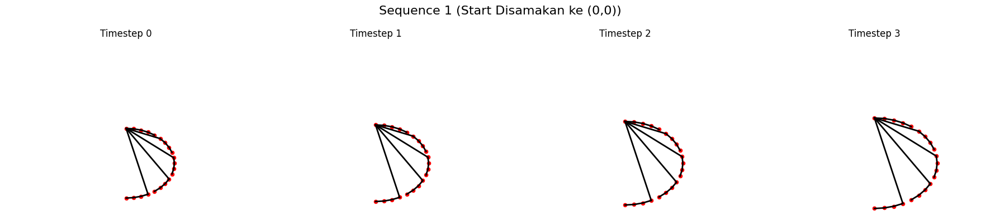

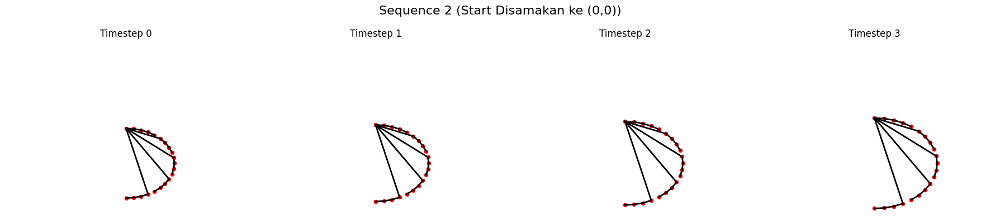

ModuleNotFoundError: No module named 'ace_tools'

In [ ]:
# Ulangi generate + visualisasi + translasi sekaligus, semua lengkap dalam satu script

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

n_timestep = 4
n_points = 21

def generate_pattern(start_x, start_y):
    pattern = []
    for t in range(n_timestep):
        frame = {'timestep': t}
        angle_offset = np.linspace(-np.pi/2, np.pi/2, n_points)
        radius = 20 + t * 2  # bertambah seiring timestep
        x_coords = start_x + radius * np.cos(angle_offset)
        y_coords = start_y + radius * np.sin(angle_offset)
        for i in range(n_points):
            frame[f'X{i}'] = x_coords[i]
            frame[f'Y{i}'] = y_coords[i]
        pattern.append(frame)
    return pattern

# Buat 2 sequence dengan posisi awal berbeda tapi pola sama
pattern1 = generate_pattern(start_x=30, start_y=50)
pattern2 = generate_pattern(start_x=60, start_y=45)

df1 = pd.DataFrame(pattern1)
df1['sequence'] = 1
df2 = pd.DataFrame(pattern2)
df2['sequence'] = 2
df_all = pd.concat([df1, df2], ignore_index=True)

# Translasi ke titik awal agar X0, Y0 pada timestep=0 menjadi (0, 0)
start_points = df_all[df_all['timestep'] == 0].groupby('sequence')[['X0', 'Y0']].first()
df_all = df_all.merge(start_points, on='sequence', suffixes=('', '_start'))

for i in range(n_points):
    df_all[f'X{i}'] -= df_all['X0_start']
    df_all[f'Y{i}'] -= df_all['Y0_start']

df_all.drop(columns=['X0_start', 'Y0_start'], inplace=True)

# Visualisasi
def plot_stickman_sequence(df, sequence_id, title):
    fig, axes = plt.subplots(1, n_timestep, figsize=(18, 4))
    fig.suptitle(title, fontsize=16)
    
    connections = [
        (0, 1), (1, 2), (2, 3), (3, 4),
        (0, 5), (5, 6), (6, 7), (7, 8),
        (0, 9), (9,10), (10,11), (11,12),
        (0,13), (13,14), (14,15), (15,16),
        (0,17), (17,18), (18,19), (19,20)
    ]
    
    for t in range(n_timestep):
        ax = axes[t]
        df_t = df[(df['sequence'] == sequence_id) & (df['timestep'] == t)]
        x_vals = [df_t[f'X{i}'].values[0] for i in range(n_points)]
        y_vals = [df_t[f'Y{i}'].values[0] for i in range(n_points)]

        for i, j in connections:
            ax.plot([x_vals[i], x_vals[j]], [y_vals[i], y_vals[j]], 'k-', lw=2)
        ax.scatter(x_vals, y_vals, color='red', s=20)

        ax.set_title(f'Timestep {t}')
        ax.set_xlim(-50, 50)
        ax.set_ylim(-50, 50)
        ax.invert_yaxis()
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Plot setelah translasi
plot_stickman_sequence(df_all, sequence_id=1, title="Sequence 1 (Start Disamakan ke (0,0))")
plot_stickman_sequence(df_all, sequence_id=2, title="Sequence 2 (Start Disamakan ke (0,0))")

# Tampilkan dataframe hasil akhir
import ace_tools as tools; tools.display_dataframe_to_user(name="Data Setelah Translasi", dataframe=df_all)


/tmp/ipykernel_99858/2509892857.py:68: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', 5)


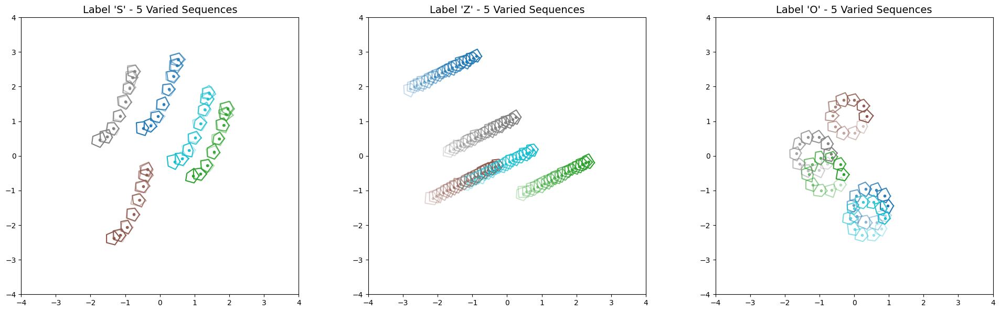

In [37]:
# Jalankan ulang blok kode yang diminta agar menghasilkan DataFrame dan visualisasi sesuai
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# Konfigurasi
labels = ['S', 'Z', 'O']
timestep_map = {'S': 15, 'Z': 20, 'O': 10}
n_points = 5
sequences_per_label = 5
np.random.seed(42)

# Fungsi bentuk pentagon
def pentagon_shape():
    angles = np.linspace(0, 2 * np.pi, n_points, endpoint=False)
    return np.array([[np.cos(a), np.sin(a)] for a in angles]) * 0.2

# Fungsi gerakan pusat segilima
def center_trajectory(label, t, T):
    if label == 'S':
        x = np.sin(np.pi * t / T)
        y = -np.cos(2 * np.pi * t / T)
    elif label == 'Z':
        x = 1 - 2 * (t / T)
        y = 1 - (t / T)
    elif label == 'O':
        angle = 2 * np.pi * t / T
        x = 0.5 * np.cos(angle)
        y = 0.5 * np.sin(angle)
    return np.array([x, y])

# Generate posisi awal unik per sequence per label
start_positions = {
    label: [np.array([np.random.uniform(-2, 2), np.random.uniform(-2, 2)]) for _ in range(sequences_per_label)]
    for label in labels
}

# Bangun dataset
all_data = []
sequence_id = 0
for label in labels:
    T = timestep_map[label]
    for seq_num in range(sequences_per_label):
        shift = start_positions[label][seq_num]
        for t in range(T):
            center = center_trajectory(label, t, T) + shift
            shape = pentagon_shape()
            jitter = np.random.normal(0, 0.02, shape.shape)
            coords = shape + jitter + center
            row = {f'X{i}': coords[i, 0] for i in range(n_points)}
            row.update({f'Y{i}': coords[i, 1] for i in range(n_points)})
            row['timestep'] = t
            row['sequence'] = sequence_id
            row['Label'] = label
            all_data.append(row)
        sequence_id += 1

df_varied_start = pd.DataFrame(all_data)

# Visualisasi semua 5 sequence per label
fig, axs = plt.subplots(1, 3, figsize=(20, 6))

for idx, label in enumerate(labels):
    ax = axs[idx]
    df_label = df_varied_start[df_varied_start['Label'] == label]
    sequences = sorted(df_label['sequence'].unique())
    cmap = cm.get_cmap('tab10', 5)

    for i, seq_id in enumerate(sequences):
        seq_df = df_label[df_label['sequence'] == seq_id]
        timesteps = sorted(seq_df['timestep'].unique())
        T = len(timesteps)
        for t_idx, t in enumerate(timesteps):
            frame = seq_df[seq_df['timestep'] == t]
            x = [frame[f'X{j}'].values[0] for j in range(n_points)] + [frame[f'X0'].values[0]]
            y = [frame[f'Y{j}'].values[0] for j in range(n_points)] + [frame[f'Y0'].values[0]]
            alpha = 1.0 - (t_idx / T) * 0.8
            ax.plot(x, y, color=cmap(i), alpha=alpha)
            ax.plot(np.mean(x), np.mean(y), 'o', color=cmap(i), alpha=alpha, markersize=3)

    ax.set_title(f"Label '{label}' - 5 Varied Sequences", fontsize=14)
    ax.set_xlim(-4, 4)
    ax.set_ylim(-4, 4)
    ax.set_aspect('equal')

plt.tight_layout()
plt.show()


In [40]:
# Ubah nilai 'sequence' agar dimulai dari 0 untuk setiap label secara terpisah
df_varied_start_sorted = df_varied_start.sort_values(['Label', 'sequence', 'timestep']).copy()

# Buat sequence index ulang per label
df_varied_start_sorted['sequence'] = (
    df_varied_start_sorted.groupby('Label')['sequence'].transform(lambda x: pd.factorize(x)[0])
)

# Cek hasil setelah transformasi
df_varied_start_sorted[['Label', 'sequence']].drop_duplicates().sort_values(['Label', 'sequence'])
df_varied_start_sorted


,X0,X1,X2,X3,X4,Y0,Y1,Y2,Y3,Y4,timestep,sequence,Label
175,1.135176,1.000629,0.757482,0.755514,1.010864,-1.442765,-1.265662,-1.326130,-1.544380,-1.661387,0,0,O
176,1.045736,0.920107,0.652613,0.686914,0.917987,-1.163175,-0.931112,-1.028274,-1.252262,-1.353383,1,0,O
177,0.795539,0.685244,0.478140,0.425949,0.627661,-0.982417,-0.775859,-0.850152,-1.114328,-1.188390,2,0,O
178,0.498246,0.323083,0.121438,0.163344,0.349336,-0.956322,-0.758384,-0.846003,-1.066117,-1.174531,3,0,O
179,0.199867,0.100484,-0.121525,-0.123397,0.108080,-1.162515,-0.977664,-1.029038,-1.278689,-1.329504,4,0,O
...,...,...,...,...,...,...,...,...,...,...,...,...,...
170,-0.582939,-0.703071,-0.938493,-0.934412,-0.694418,-0.568922,-0.358108,-0.474513,-0.708704,-0.807621,15,4,Z
171,-0.693294,-0.791410,-1.036112,-1.032622,-0.828964,-0.656439,-0.410660,-0.520903,-0.729403,-0.820527,16,4,Z
172,-0.752716,-0.906625,-1.188088,-1.147105,-0.900192,-0.675062,-0.474851,-0.553969,-0.839253,-0.847822,17,4,Z
173,-0.874969,-0.978171,-1.201224,-1.232515,-1.015338,-0.716026,-0.518574,-0.602684,-0.884680,-0.942160,18,4,Z


/tmp/ipykernel_99858/3083141741.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', len(sequences))


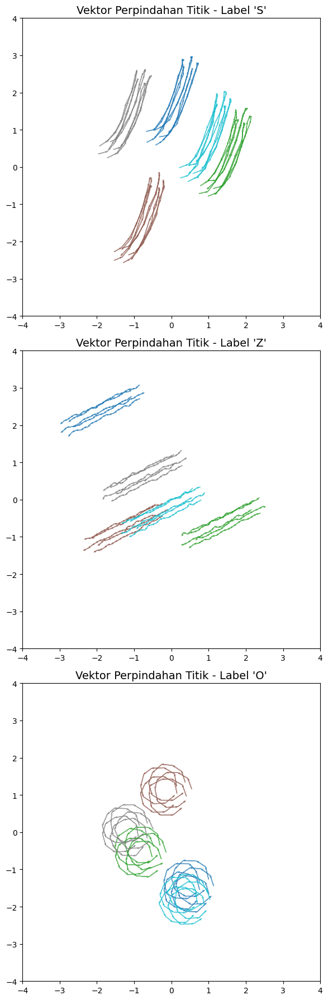

In [43]:
# Visualisasi vektor perpindahan (bukan garis penghubung langsung)
# Tiap panah menunjukkan arah dan panjang perpindahan posisi titik dari t ke t+1

fig, axs = plt.subplots(3, 1, figsize=(10, 18))
point_indices = range(n_points)

for idx, label in enumerate(labels):
    ax = axs[idx]
    df_label = df_varied_start_sorted[df_varied_start_sorted['Label'] == label]
    sequences = sorted(df_label['sequence'].unique())
    cmap = cm.get_cmap('tab10', len(sequences))

    for i, seq_id in enumerate(sequences):
        seq_df = df_label[df_label['sequence'] == seq_id].sort_values('timestep')
        for point_id in point_indices:
            x = seq_df[f'X{point_id}'].values
            y = seq_df[f'Y{point_id}'].values

            for t in range(len(x) - 1):
                dx = x[t + 1] - x[t]
                dy = y[t + 1] - y[t]
                ax.arrow(
                    x[t], y[t], dx, dy,
                    head_width=0.03, head_length=0.05,
                    fc=cmap(i), ec=cmap(i), alpha=0.7, length_includes_head=True
                )

    ax.set_title(f"Vektor Perpindahan Titik - Label '{label}'", fontsize=14)
    ax.set_xlim(-4, 4)
    ax.set_ylim(-4, 4)
    ax.set_aspect('equal')

plt.tight_layout()
plt.show()
